In [1]:
dir_ = '/mnt/archive/Antonio/data/manta/smdata/2017-07-21/'
fname = dir_ + '04_7d_3nM_D-200mW_A-400mW.hdf5'

In [2]:
plot_timetraces = True
and_gate_size_sel_kws = dict(th1=20, gamma=0.5, add_aex=True)
and_gate_min_rate_cps = 30e3
skip_ch = (12, 13)

In [3]:
from pathlib import Path

In [4]:
fname = Path(fname)

In [5]:
num_fields = 3
max_len = 26
mlabel = '_'.join([fname.parts[-2]] + fname.stem.split('_')[:num_fields])[:max_len]
mlabel

'2017-07-21_04_7d_3nM'

In [6]:
assert fname.is_file(), 'File not found.'

# Imports

In [7]:
import os
from pathlib import Path
import numpy as np
from IPython.display import display, HTML, Math
import pandas as pd
import matplotlib as mpl
mpl.rcParams['font.sans-serif'].insert(0, 'Arial')
%matplotlib inline
import matplotlib.pyplot as plt
from heatmap import heatmap48, spotsh, spotsv
import pybroom as br

/home/anto/miniconda3/envs/py36/lib/python3.6/site-packages/seaborn/apionly.py:6: UserWarning: As seaborn no longer sets a default style on import, the seaborn.apionly module is deprecated. It will be removed in a future version.
  warnings.warn(msg, UserWarning)


In [8]:
plt.rcParams['font.size'] = 14

In [9]:
%config InlineBackend.figure_format = 'retina'

In [10]:
from fretbursts import *

 - Optimized (cython) burst search loaded.
 - Optimized (cython) photon counting loaded.
--------------------------------------------------------------
 You are running FRETBursts (version 0.6.4+59.gc97d4a8).

 If you use this software please cite the following paper:

   FRETBursts: An Open Source Toolkit for Analysis of Freely-Diffusing Single-Molecule FRET
   Ingargiola et al. (2016). http://dx.doi.org/10.1371/journal.pone.0160716 

--------------------------------------------------------------


In [11]:
sns = init_notebook(apionly=True)

In [12]:
pd.options.display.max_columns = 48
pd.options.display.max_rows = 48

def make_df_bursts(list_of_columns):
    ncols = 48
    assert len(list_of_columns) == ncols
    nrows = max(len(x) for x in list_of_columns)
    columns = np.arange(ncols)
    df = pd.DataFrame(columns=columns, index=np.arange(nrows), dtype=float)
    df.columns.name = 'spot'
    for col, col_data in zip(columns, list_of_columns):
        df.iloc[:len(col_data), col] = col_data
    return df

def make_df_spots(list_of_tuples=None):
    nrows = 48
    df = pd.DataFrame(index=np.arange(nrows))
    if list_of_tuples is None:
        list_of_tuples = []
    for col, col_data in list_of_tuples:
        df[col] = col_data
    return df

In [13]:
def cal_phrate(d, stream, phrates=None, recompute=False):
    Path('results').mkdir(exist_ok=True)
    if phrates is None:
        phrates = {}
    phrates_fname = Path('results/%s_phrate_%s.csv' % (mlabel, stream))
    phrates_fnameB = Path('results/%s_phrate_%sB.csv' % (mlabel, stream))
    if phrates_fname.is_file() and not recompute:
        phrates[str(stream)] = pd.read_csv(phrates_fname, index_col=0)
        phrates[str(stream)].index.name = 'spot'
        phr = pd.read_csv(phrates_fnameB, index_col=0)
        phr.columns = [int(c) for c in phr.columns]
        phr.columns.name = 'spot'
        phrates[str(stream)+'B'] = phr
    else:
        try:
            d.calc_max_rate(m=10, ph_sel=stream, compact=True)
        except ValueError:
            d.calc_max_rate(m=10, ph_sel=stream, compact=False)
        phrates[str(stream)+'B'] = make_df_bursts(d.max_rate)
        phrates[str(stream)] = (make_df_spots()
                        .assign(**{'num_bursts': d.num_bursts})
                        .assign(**{'num_nans': [np.isnan(x).sum() for x in d.max_rate]})
                        .assign(**{'num_valid': lambda x: x.num_bursts - x.num_nans})
                        .assign(**{'valid_fraction': lambda x: 100 * x.num_valid / x.num_bursts})
                      )
        phrates[str(stream)].to_csv(phrates_fname)
        phrates[str(stream)+'B'].to_csv(phrates_fnameB)

    print('   Valid fraction (mean of all ch): %.1f %%' %
          phrates[str(stream)].valid_fraction.mean())
    return phrates

In [14]:
def info_html(d):
    Dex, Aex = d.setup['excitation_input_powers']*1e3
    s = """
    <h3>File: &nbsp; &nbsp; &nbsp; {fname}</h3>
    <blockquote><p class="lead">{descr}</p></blockquote>
    <ul>
    <li><span style='display: inline-block; width: 150px;'>Acquisition duration:</span> {time:.1f} s </li>
    <li><span style='display: inline-block; width: 150px;'>Laser power:</span>  <b>{Dex:.0f}mW</b> @ 532nm &nbsp;&nbsp;&nbsp;  
                                                                                <b>{Aex:.0f}mW</b> @ 628nm </li>
    <li><span style='display: inline-block; width: 150px;'>ALEX period [offset]: </span> {period} ({period_us:.1f} μs)  [{offset}] </li></ul>
    """.format(fname=fname, time=float(d.acquisition_duration), Dex=Dex, Aex=Aex, 
               period=d.alex_period, period_us=d.alex_period*d.clk_p*1e6, offset=d.offset,
               descr=d.description.decode())
    return HTML(s)

In [15]:
save_figures = True
savefigdir = 'figures'
highres = True

def save_name(name, folder='.', nospaces=False):
    sname = '%s/%s_%s' % (folder, mlabel, name)
    if nospaces:
        sname = sname.replace(' ', '_')
    return sname 
    
def savefig(name, nospaces=True, **kwargs):
    if not save_figures:
        return
    savefigpath = Path(savefigdir)
    savefigpath.mkdir(exist_ok=True)
    kwargs_ = dict(dpi=100, bbox_inches='tight')
                   #frameon=True, facecolor='white', transparent=False)
    kwargs_.update(kwargs)
    fname = save_name(name, savefigdir, nospaces=nospaces)
    plt.savefig(fname, **kwargs_)
    print('Saved: %s.png' % fname, flush=True)
    if highres:
        kwargs_['dpi'] = 300
        fname = save_name(name.strip('.png') + '_highres', savefigdir, nospaces=nospaces)
        print('Saved hires: %s.png' % fname, flush=True)
        plt.savefig(fname, **kwargs_)

# Load Data

In [16]:
d = loader.photon_hdf5(str(fname), ondisk=True)

In [17]:
info_html(d)

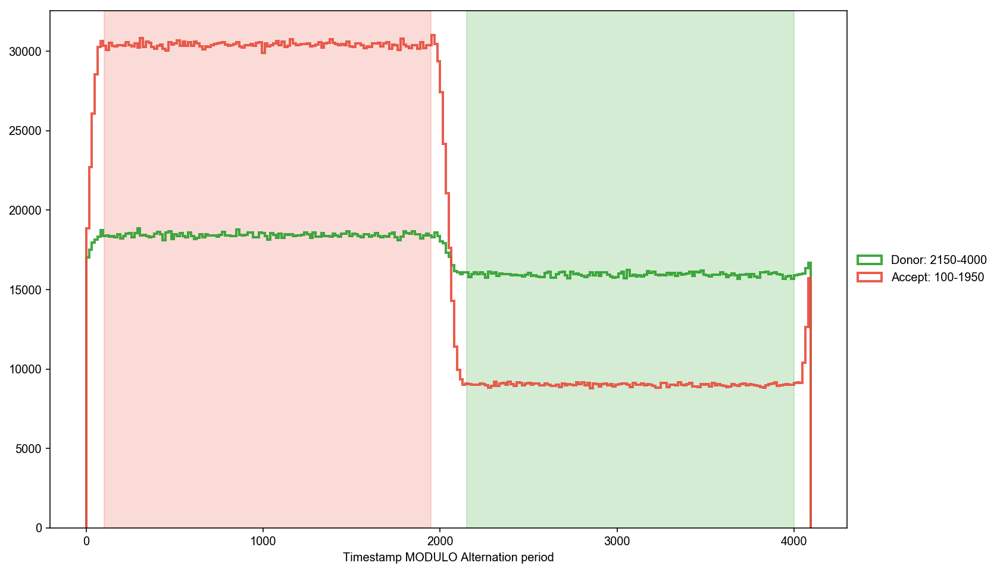

In [18]:
fig, ax = plt.subplots(figsize=(12, 8))
bpl.plot_alternation_hist_usalex(d, ax=ax, bins=np.arange(0, 4097, 16))

In [19]:
%%timeit -n1 -r1 
loader.alex_apply_period(d)

# Total photons (after ALEX selection):   423,181,011
#  D  photons in D+A excitation periods:  217,964,031
#  A  photons in D+A excitation periods:  205,216,980
# D+A photons in  D  excitation period:   171,040,756
# D+A photons in  A  excitation period:   252,140,255

2min 5s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


# Analysis

## Timetraces

Saved: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=1-2.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=1-2_highres.png
Saved: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=137-138.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=137-138_highres.png
Saved: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=273-274.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=273-274_highres.png
Saved: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=409-410.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=409-410_highres.png
Saved: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=545-546.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_2017-07-21_04_7d_3nM_timetrace_t=545-546_highres.png


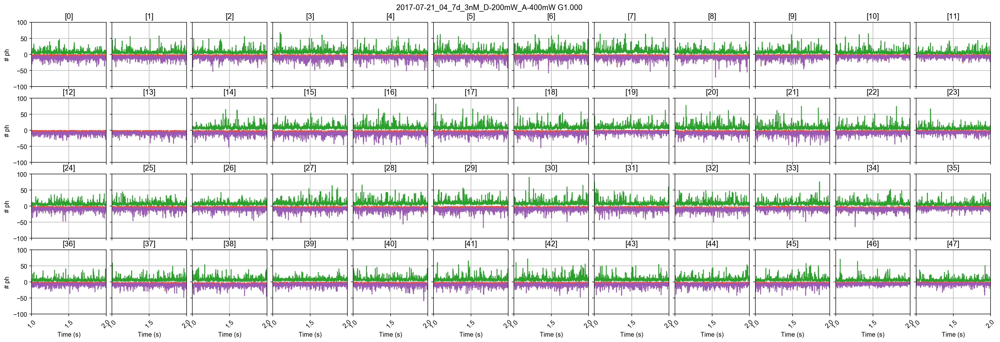

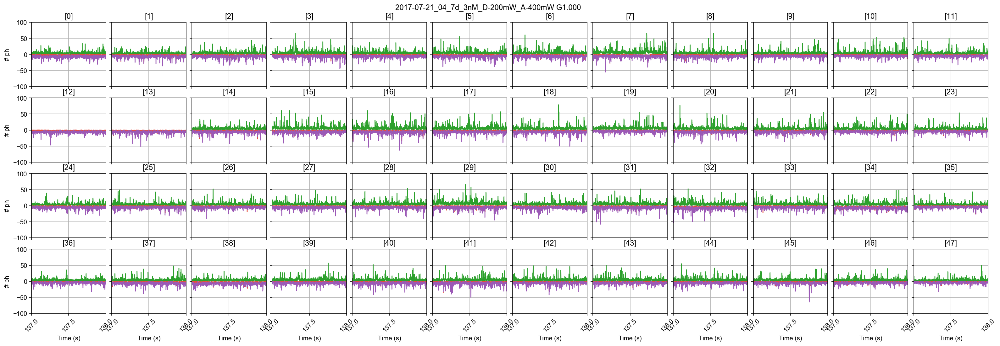

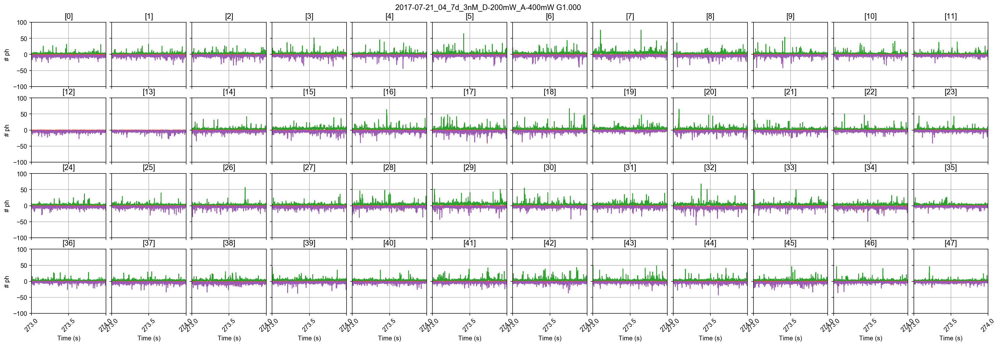

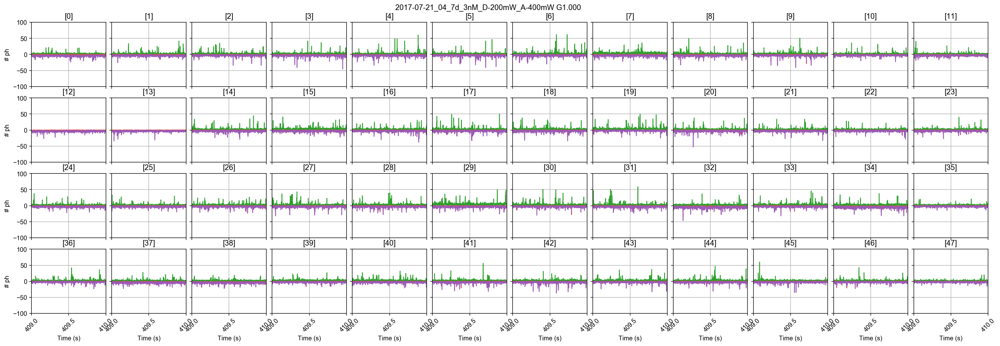

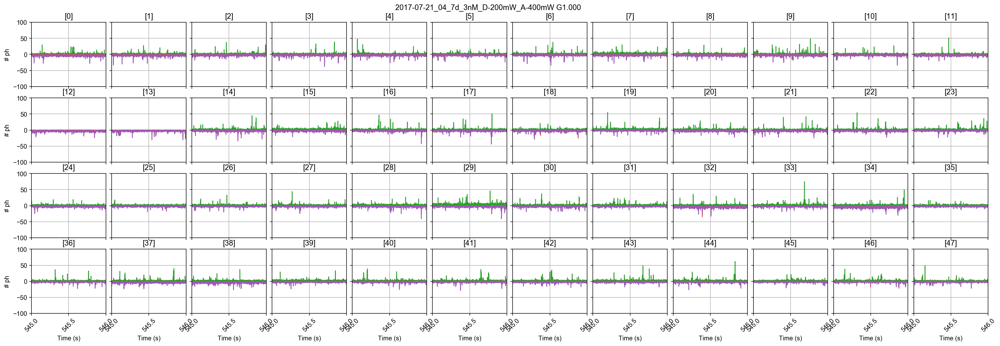

In [20]:
if plot_timetraces:
    num_time_points = 5
    kws = dict(figsize=(24, 8), xrotation=45)
    
    # Timepoints equally distributed along the measurement
    time_points = np.round(np.linspace(d.time_min+1, d.time_max-2, num=num_time_points))

    for i in time_points:
        dplot(d, timetrace, tmin=i, tmax=i+1, **kws);
        plt.ylim(-100, 100)
        savefig("%s_timetrace_t=%d-%d.png" % (mlabel, i, i+1))

## Background

In [21]:
d.calc_bg_cache(bg.exp_fit, time_s=5, tail_min_us='auto', F_bg=1.7)

 * Loading BG rates from cache ... 
 - Loading bakground data:  [DONE]


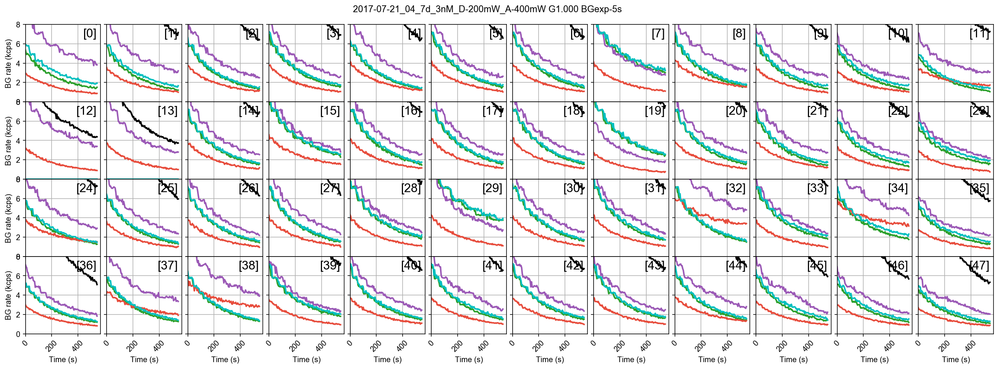

In [22]:
ax = dplot(d, timetrace_bg, show_da=True, hspace=0, wspace=0.08,
           plot_style=dict(marker=None), title='right top', 
           title_kws=dict(fontsize=16), xrotation=45);
plt.xlim(0)
plt.ylim(0, 8);

In [23]:
bg_AexDem = d.bg_from(Ph_sel(Aex='Dem'))
bg_AexAem = d.bg_from(Ph_sel(Aex='Aem'))
bg_DexDem = d.bg_from(Ph_sel(Dex='Dem'))
bg_DexAem = d.bg_from(Ph_sel(Dex='Aem'))

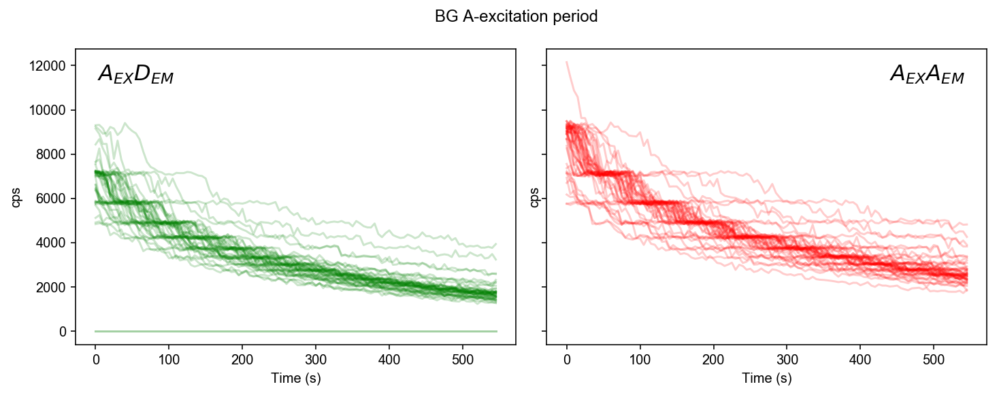

In [24]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4), sharex=True, sharey=True)
fig.suptitle("BG A-excitation period")
t = np.arange(len(bg_AexDem[0])) * 5
ax[0].plot(t, np.array(bg_AexDem).T, color='g', alpha=0.2);
ax[1].plot(t, np.array(bg_AexAem).T, color='r', alpha=0.2);
plt.setp(ax, xlabel='Time (s)', ylabel='cps')
plt.subplots_adjust(wspace=0.07)
ax[0].text(0.05, 0.95, '$A_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$A_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes);

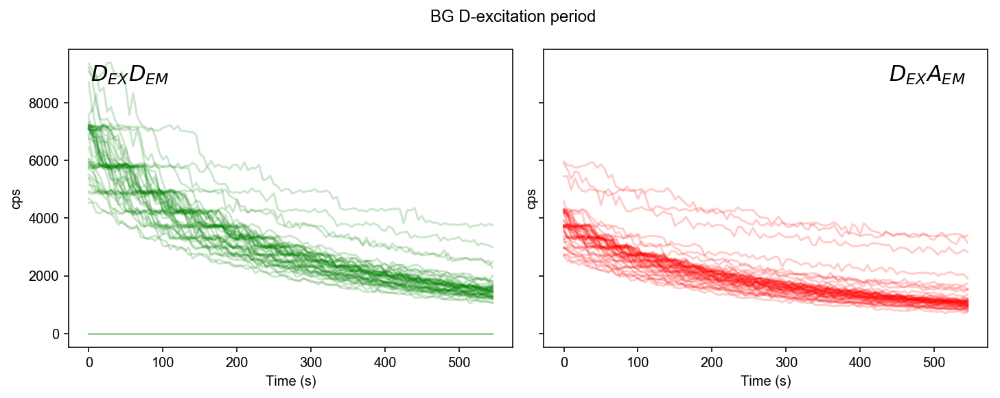

In [25]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4), sharex=True, sharey=True)
fig.suptitle("BG D-excitation period")
t = np.arange(len(bg_DexDem[0])) * 5
ax[0].plot(t, np.array(bg_DexDem).T, color='g', alpha=0.2);
ax[1].plot(t, np.array(bg_DexAem).T, color='r', alpha=0.2);
plt.setp(ax, xlabel='Time (s)', ylabel='cps')
plt.subplots_adjust(wspace=0.07)
ax[0].text(0.05, 0.95, '$D_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$D_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes);

## Burst search

In [26]:
d.burst_search(min_rate_cps=50e3, pax=True)

 - Performing burst search (verbose=False) ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]


In [27]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in')

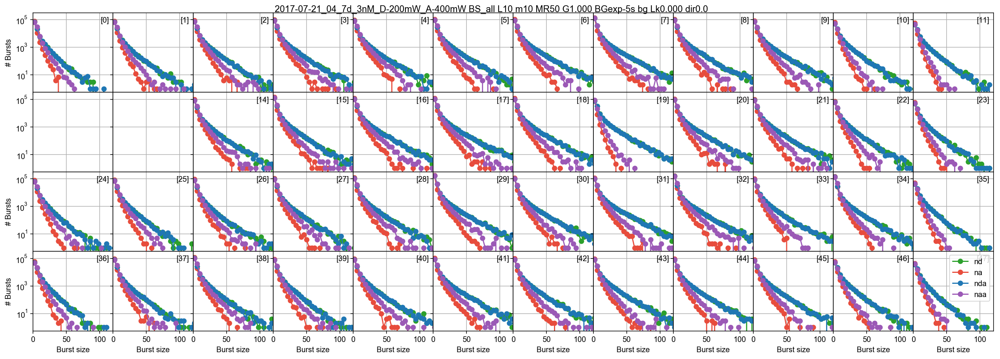

In [28]:
dplot(d, hist_size_all, **kws);
plt.xlim(0, 120)
plt.legend();

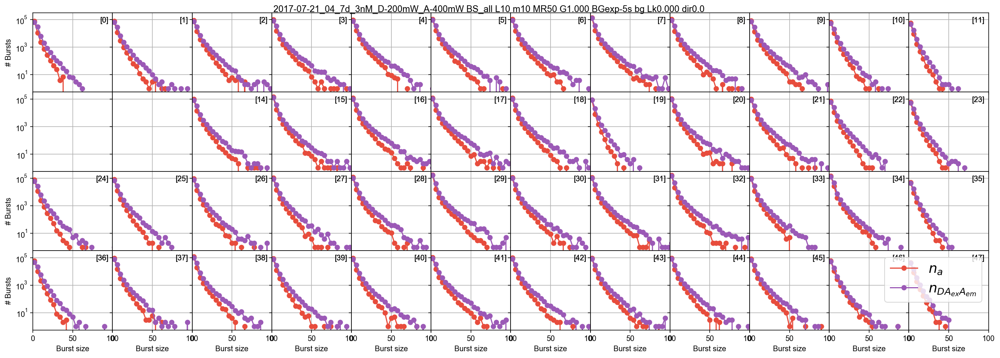

In [29]:
kws.update(title_nbursts=False)
ax = dplot(d, hist_size, which='na', **kws);
dplot(d, hist_size, which='naa', AX=ax, **kws);
plt.xlim(0, 100);
plt.legend(['$n_a$', '$n_{DA_{ex}A_{em}}$'], fontsize=18, loc='upper right')

<IPython.core.display.Math object>

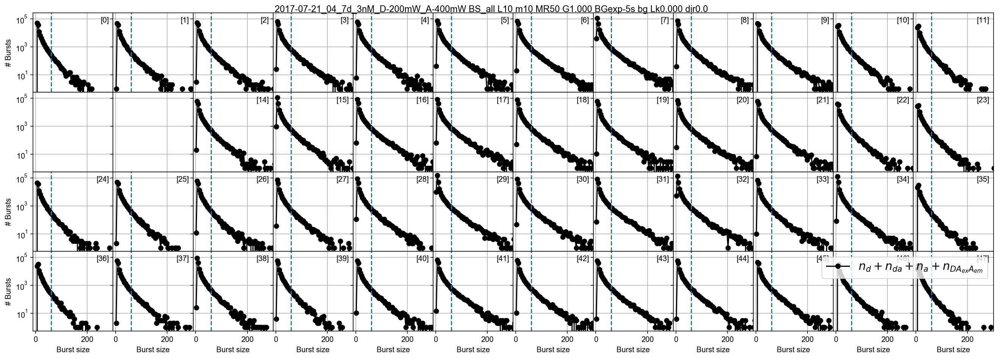

In [30]:
size_th = 60
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d, hist_size, vline=size_th, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.legend(fontsize=15, loc='upper right');
Math(d._burst_sizes_pax_formula(**size_sel_kws))

In [31]:
bs_mean = []
for i in range(48):
    sizes_ch = d.burst_sizes_pax_ich(i, **size_sel_kws) 
    tail = sizes_ch > size_th
    bs_mean.append(sizes_ch[tail].mean() - size_th)

Saved: figures/2017-07-21_04_7d_3nM_heatmap_burst_sizes.png
Saved hires: figures/2017-07-21_04_7d_3nM_heatmap_burst_sizes_highres.png


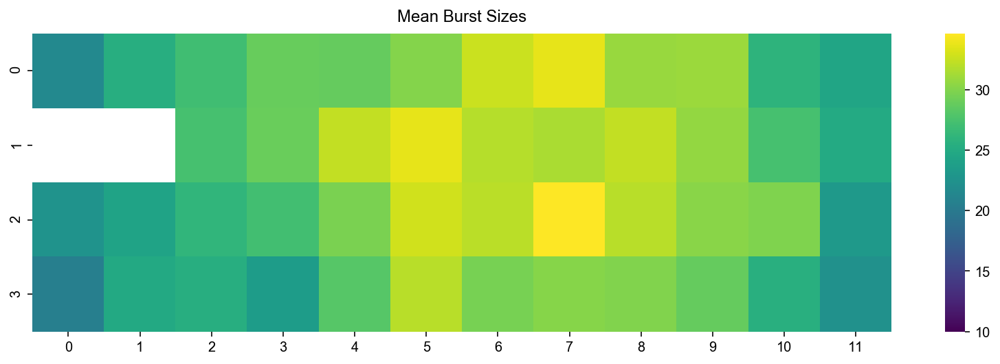

In [32]:
heatmap48(bs_mean, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Sizes", vmin=10)
savefig('heatmap_burst_sizes')

(-0.5, 4)

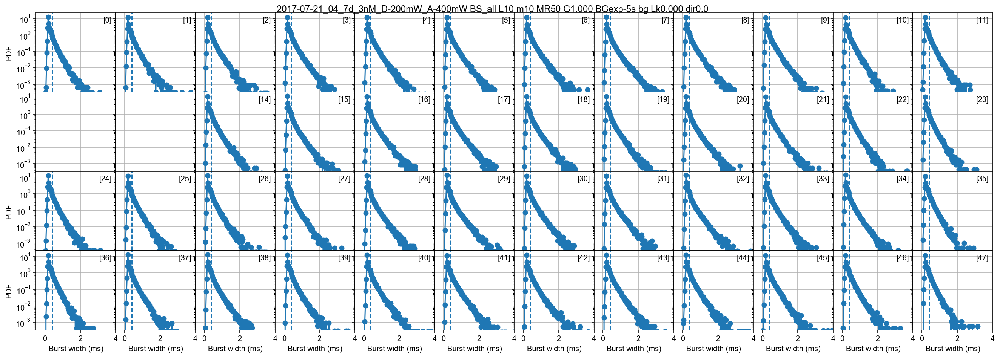

In [33]:
width_th = 0.4
dplot(d, hist_width, vline=width_th, **kws);
plt.xlim(-0.5, 4)

In [34]:
bw_mean = []
for i in range(48):
    widths_ch = d.mburst[i].width * d.clk_p * 1e3
    tail = widths_ch > width_th
    bw_mean.append(widths_ch[tail].mean() - width_th)

Saved: figures/2017-07-21_04_7d_3nM_heatmap_burst_widths.png
Saved hires: figures/2017-07-21_04_7d_3nM_heatmap_burst_widths_highres.png


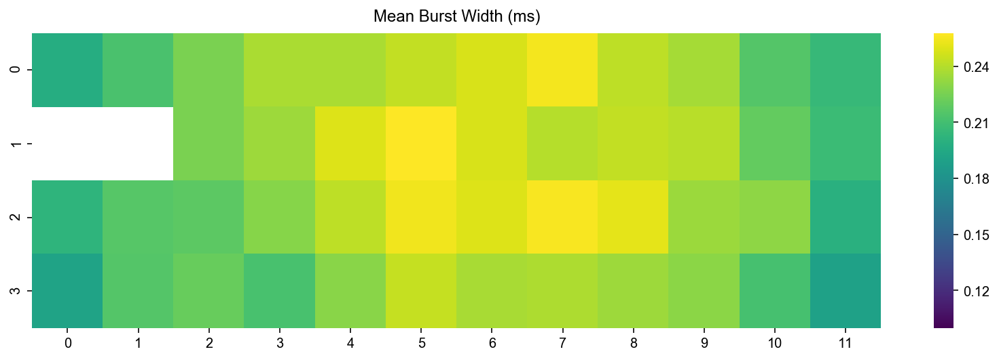

In [35]:
heatmap48(bw_mean, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Width (ms)", vmin=0.1)
savefig('heatmap_burst_widths')

In [36]:
# Use recompute=True if changing burst-search parameters
recompute = False
phrates = {}
streams = ('all', 'DexDem', 'AexDem', 'DexAem', 'AexAem', )
for stream in streams:
    print(' - Computing peak photon rates for %6s stream.' % str(Ph_sel.from_str(stream)))
    cal_phrate(d, stream=Ph_sel.from_str(stream), phrates=phrates, recompute=recompute)

 - Computing peak photon rates for    all stream.
   Valid fraction (mean of all ch): 100.0 %
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 12.9 %
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 13.1 %
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 4.1 %
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 11.9 %


Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_all.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_all_highres.png


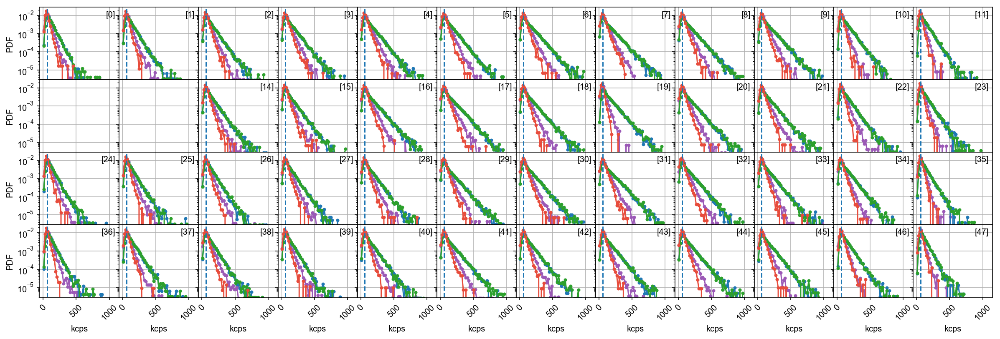

In [37]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, ms=3), **kws);
dplot(phrates['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', ms=3), AX=ax, **kws);
dplot(phrates['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, ms=3), AX=ax, **kws);
kws.update(vline=60, title='in', title_nbursts=False, title_bg=False,)
dplot(phrates['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, ms=3), AX=ax, **kws);
plt.xlim(-50, 1150);
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
savefig('peak_phrate_all')

In [38]:
phr_th = 60e3
for stream in streams:
    phrates[stream]['mean'] = 0
    phr = phrates[stream+'B']
    for ich in range(48):
        valid = ~pd.isnull(phr[ich])
        phr_valid = phr[ich][valid]
        m = phr_valid[phr_valid >= phr_th].mean() - phr_th
        phrates[stream].loc[ich, 'mean'] = np.round(m*1e-3, 1)

In [39]:
streams

('all', 'DexDem', 'AexDem', 'DexAem', 'AexAem')

Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_heatmap_all.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_heatmap_all_highres.png
Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_heatmap_DexDem.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_heatmap_DexDem_highres.png
Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_heatmap_AexDem.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_heatmap_AexDem_highres.png
Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_heatmap_DexAem.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_heatmap_DexAem_highres.png
Saved: figures/2017-07-21_04_7d_3nM_peak_phrate_heatmap_AexAem.png
Saved hires: figures/2017-07-21_04_7d_3nM_eak_phrate_heatmap_AexAem_highres.png


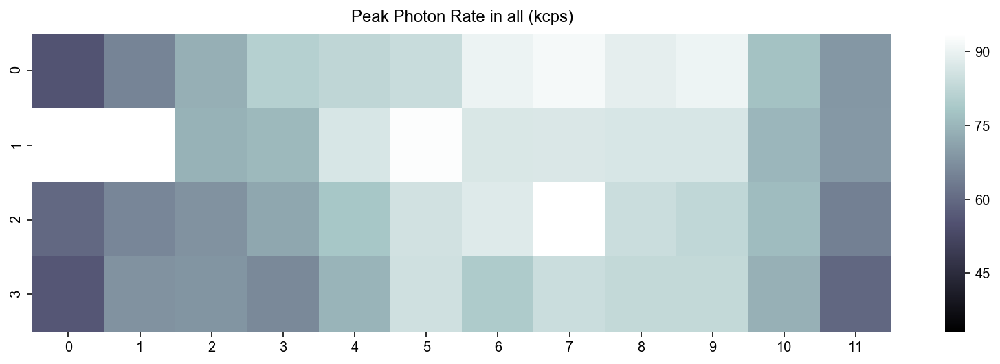

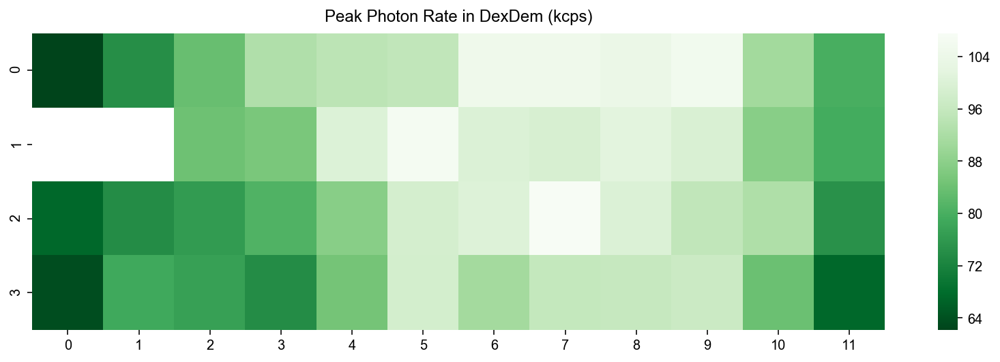

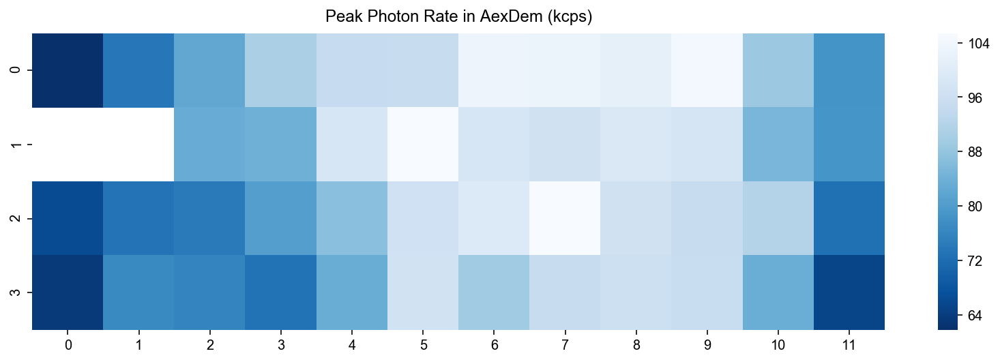

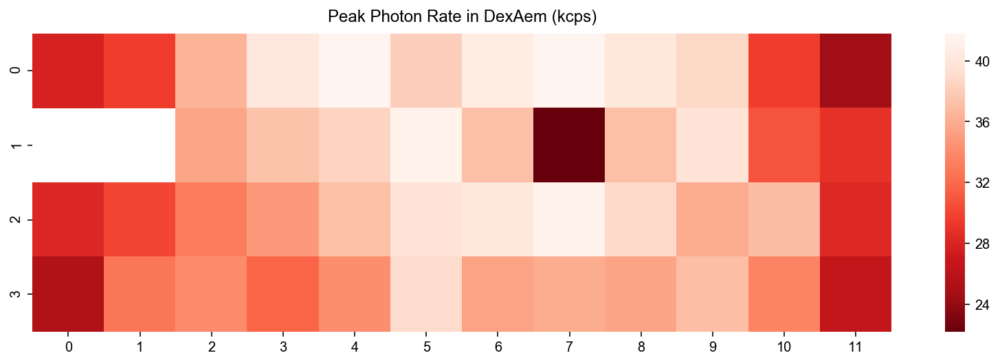

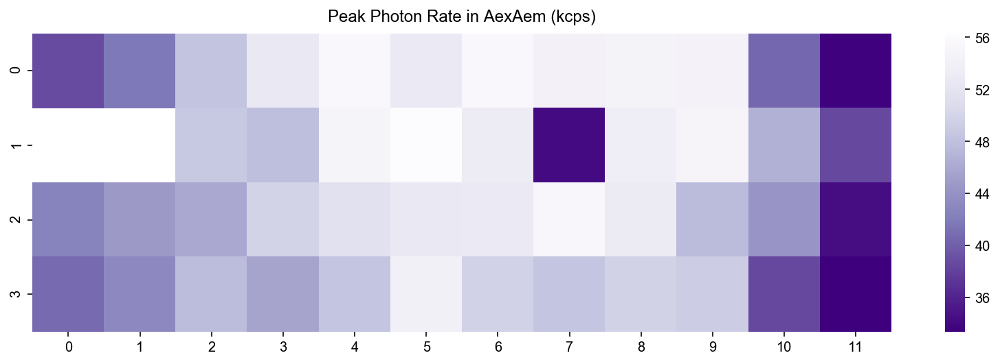

In [40]:
cmaps = ('bone', 'Greens_r', 'Blues_r', 'Reds_r', 'Purples_r')
for stream, cmap in zip(streams, cmaps):
    heatmap48(phrates[stream]['mean'], cmap=cmap, skip_ch=skip_ch,
              title="Peak Photon Rate in %s (kcps)" % stream)
    savefig('peak_phrate_heatmap_%s' % stream)

## Burst selection

In [41]:
size_th = 80
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='Dem'), gamma=0.5,
                    na_comp=True, naa_comp=False, naa_aexonly=False)
ds = d.select_bursts(select_bursts.size, th1=size_th, **size_sel_kws)

Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(ds.nd, ds.na, ds.naa)]
ds.add(Su=Su)
Su2 = [(nd + nda + na)/(nd + nda + na + naa) 
       for nd, na, nda, naa in zip(ds.nd, ds.na, ds.nda, ds.naa)]
ds.add(Su2=Su2)
Math(d._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

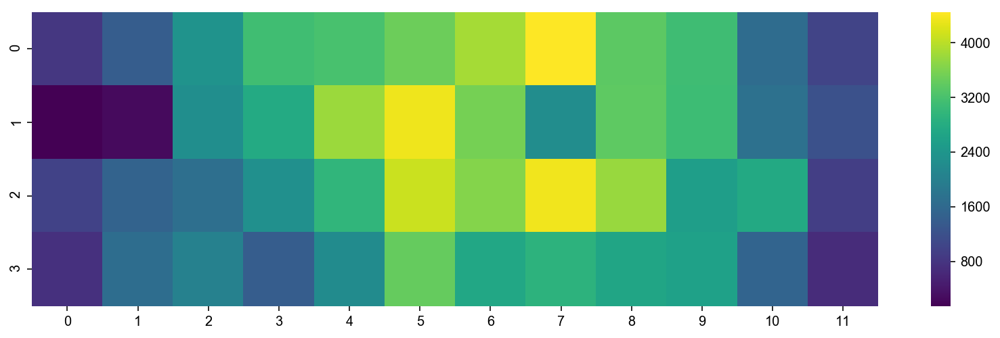

In [42]:
heatmap48(ds.num_bursts)

Saved: figures/2017-07-21_04_7d_3nM_48spot_hist_E_all-bursts.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_hist_E_all-bursts_highres.png


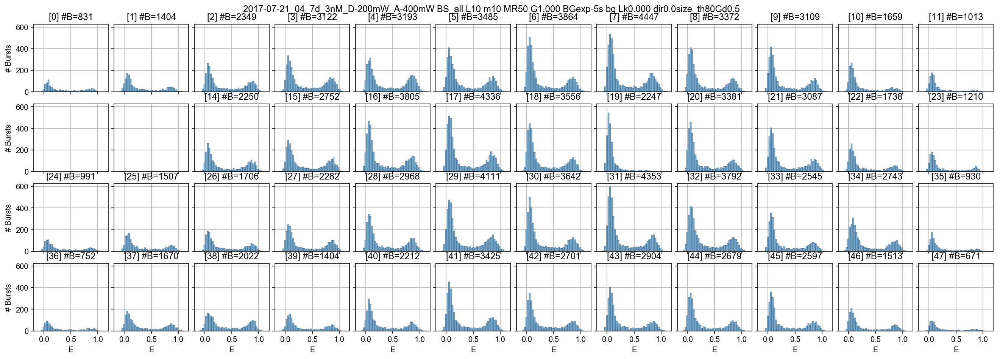

In [43]:
ax = dplot(ds, hist_fret, pdf=False, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts');
# plt.ylim(0, 600);
savefig('48spot hist E all-bursts')

Saved: figures/2017-07-21_04_7d_3nM_48spot_hist_Su.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_hist_Su_highres.png


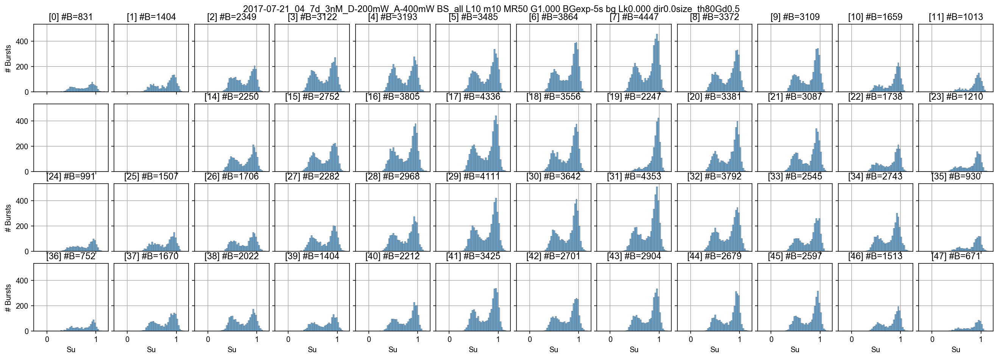

In [44]:
dplot(ds, hist_burst_data, data_name='Su', pdf=False, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts');
savefig('48spot hist Su')

Saved: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_S_all-bursts.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_S_all-bursts_highres.png


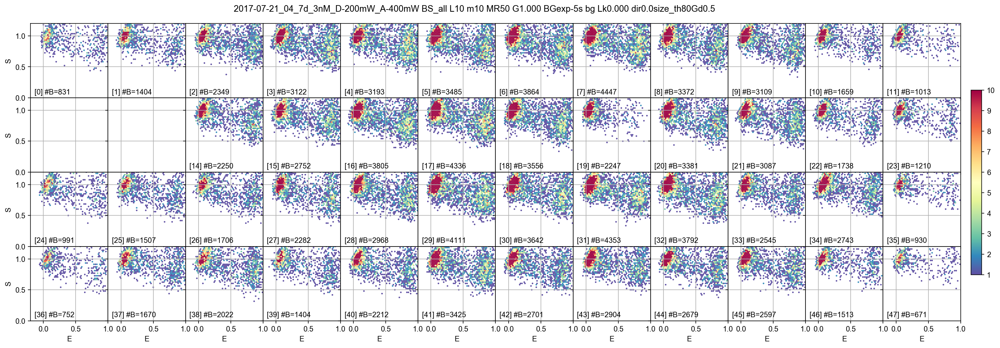

In [45]:
ax = dplot(ds, hexbin_alex, vmax=10, skip_ch=skip_ch, wspace=0, hspace=0, gridsize=60,
           title='bottom left', title_bg=False);
ax0 = ax[0,0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.colorbar(cax=cax)
plt.setp(ax[:, 0], ylabel='S');
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
savefig('48spot alex hist S all-bursts')

Saved: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_all-bursts.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_all-bursts_highres.png


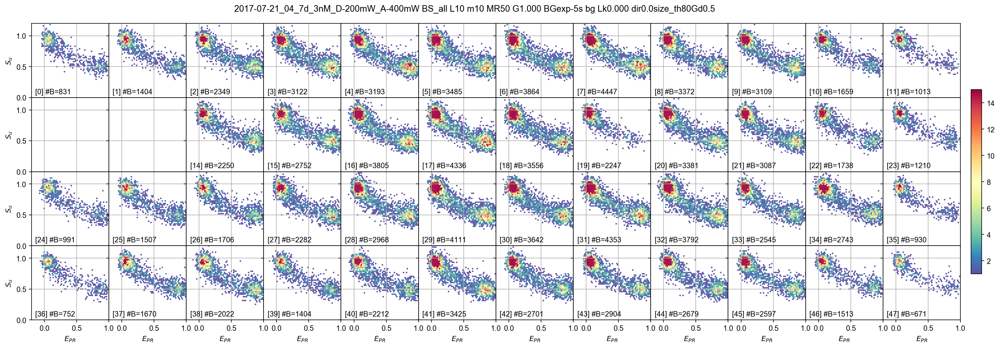

In [46]:
ax = dplot(ds, hexbin_alex, S_name='Su', vmax=15, skip_ch=skip_ch, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$');
plt.setp(ax[-1], xlabel='$E_{PR}$');
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
savefig('48spot alex hist Su all-bursts')

Saved: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_all-bursts.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_all-bursts_highres.png


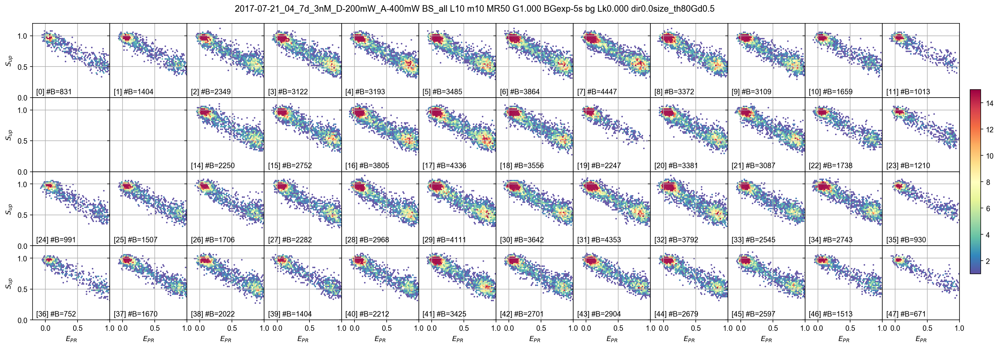

In [47]:
ax = dplot(ds, hexbin_alex, S_name='Su2', vmax=15, skip_ch=skip_ch, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_{up}$');
plt.setp(ax[-1], xlabel='$E_{PR}$');
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
savefig('48spot alex hist Su all-bursts')

In [48]:
size_Dex = 80
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='Dem'), gamma=0.5,
                    na_comp=True, naa_comp=False, naa_aexonly=False)
Math(d._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

In [49]:
size_Aex = 40
naa_sel_kws = dict(ph_sel=Ph_sel(Aex='Aem'), gamma=0.5,
                   na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d._burst_sizes_pax_formula(**naa_sel_kws))

<IPython.core.display.Math object>

In [50]:
ds1 = d.select_bursts(select_bursts.size, th1=size_Dex, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(ds1.nd, ds1.na, ds1.naa)]
ds1.add(Su=Su)
dss = ds1.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dss.nd, dss.na, dss.naa)]
dss.add(Su=Su)

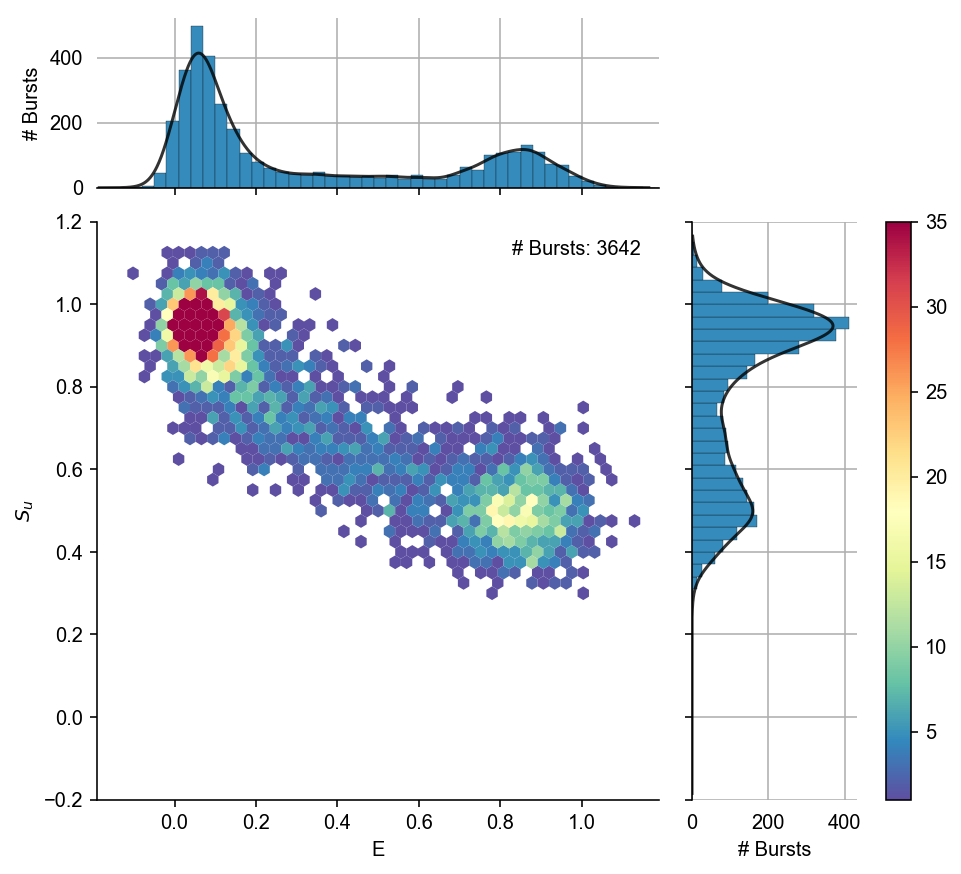

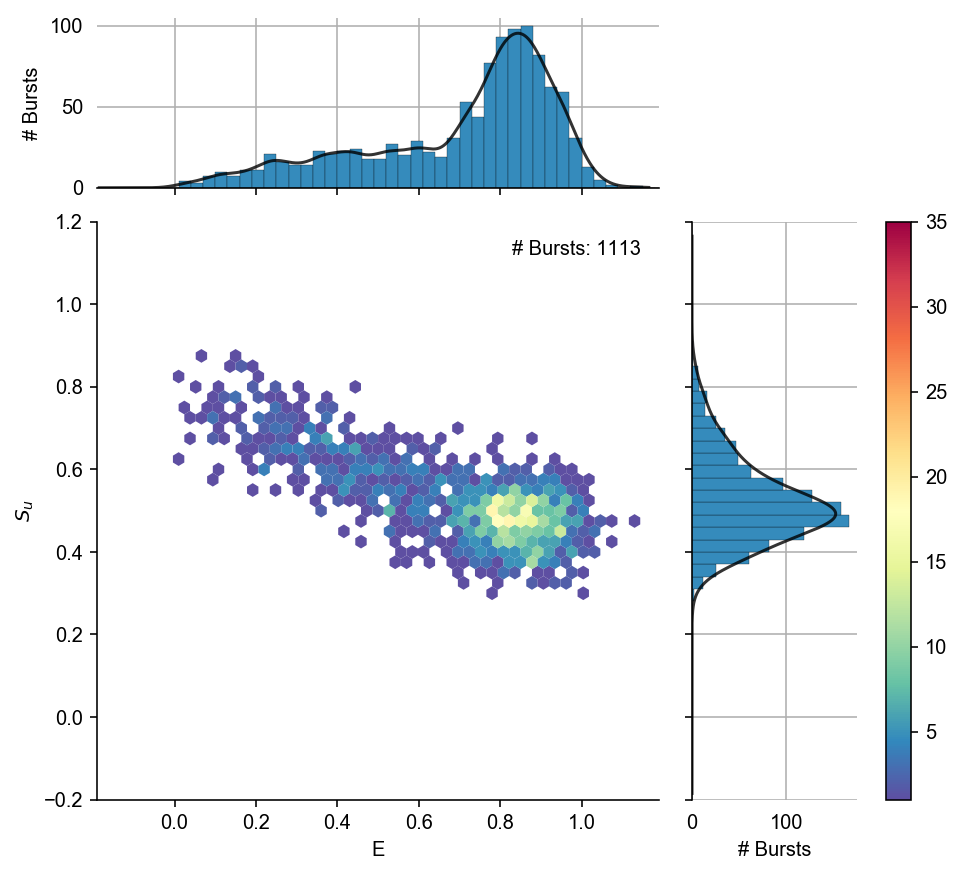

In [51]:
g = alex_jointplot(ds1, i=30, vmax=35, S_name='Su')
g.ax_joint.set_ylabel('$S_u$')
g = alex_jointplot(dss, i=30, vmax=35, S_name='Su')
g.ax_joint.set_ylabel('$S_u$')

Saved: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_naa_AND_size_selection.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_naa_AND_size_selectio_highres.png


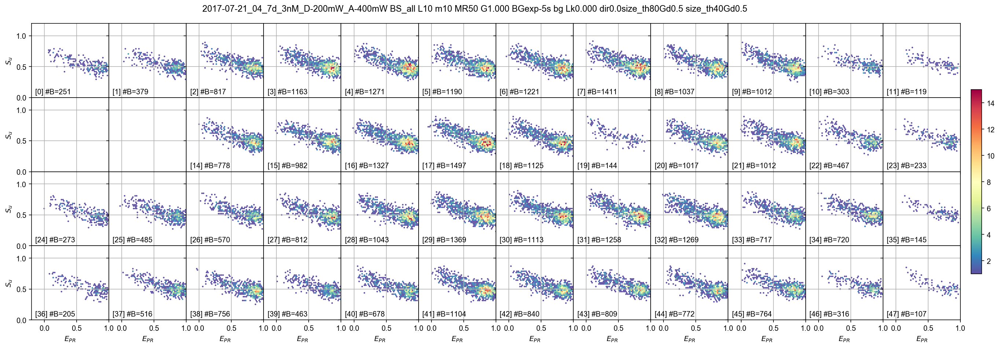

In [52]:
ax = dplot(dss, hexbin_alex, vmax=15, S_name='Su', skip_ch=skip_ch, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0,0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.colorbar(cax=cax)
plt.setp(ax[:, 0], ylabel='$S_u$');
plt.setp(ax[-1], xlabel='$E_{PR}$');
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
savefig('48spot alex hist Su naa AND size selection')

## Fitting

### FRET population fit

In [53]:
ds_fret = dss

In [54]:
E_fitter = bext.bursts_fitter(ds_fret, 'E', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.5, min=0, max=1)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.2)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center          0.5        0        1     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.2     True    


In [55]:
E_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_FRET_pop_-_E_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_pop_-_E_hist_fit_highres.png


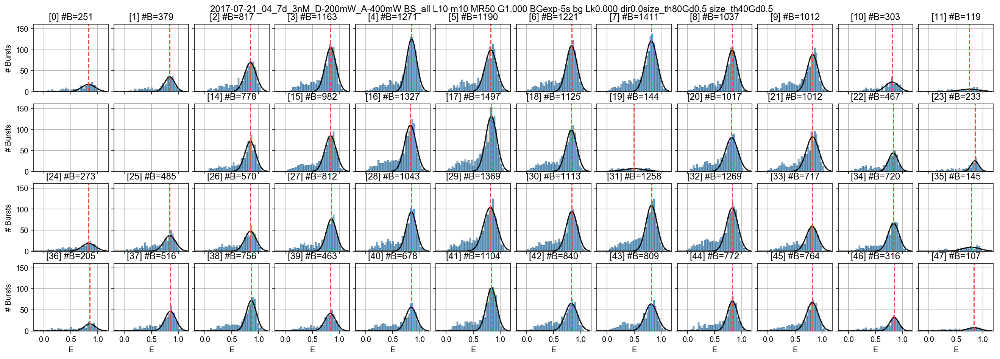

In [56]:
ax = dplot(ds_fret, hist_fret, pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('FRET pop - E hist fit')

In [57]:
S_fitter = bext.bursts_fitter(ds_fret, 'S', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.5, min=0, max=1)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.2)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center          0.5        0        1     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.2     True    


In [58]:
S_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_FRET_pop_-_E_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_pop_-_E_hist_fit_highres.png


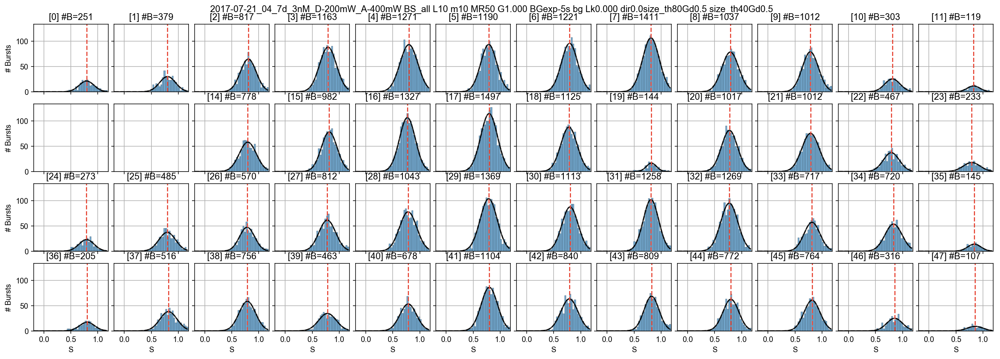

In [59]:
ax = dplot(ds_fret, hist_S, pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('FRET pop - E hist fit');

In [60]:
Su_fitter = bext.bursts_fitter(ds_fret, 'Su', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.5, min=0, max=1)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.2)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center          0.5        0        1     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.2     True    


In [61]:
Su_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_FRET_pop_-_Su_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_pop_-_Su_hist_fit_highres.png


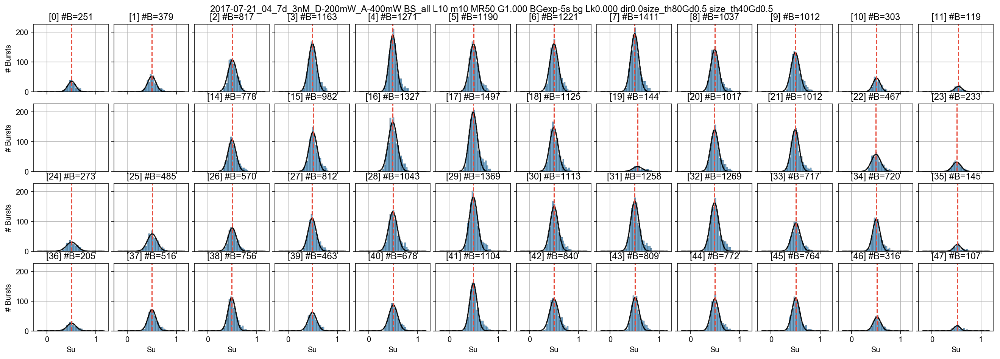

In [62]:
ax = dplot(ds_fret, hist_burst_data, data_name='Su', pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('FRET pop - Su hist fit');

### FRET population tidy

In [63]:
def make_ES_fit_dataframe(E_df_fitt, S_df_fitt, Su_df_fitt, dx, skip_ch=skip_ch):
    pop_peak = E_df_fitt.query('name == "center"').loc[:,('value', 'spot')].set_index('spot')
    pop_peak.columns = ['E']
    pop_peak['S'] = S_df_fitt.query('name == "center"').loc[:,('value', 'spot')].set_index('spot')
    pop_peak['Su'] = Su_df_fitt.query('name == "center"').loc[:,('value', 'spot')].set_index('spot')
    pop_peak['num_bursts'] = dx.num_bursts

    pop_peak['E_sigma'] = E_df_fitt.query('name == "sigma"').loc[:,('value', 'spot')].set_index('spot')
    pop_peak['S_sigma'] = S_df_fitt.query('name == "sigma"').loc[:,('value', 'spot')].set_index('spot')
    pop_peak['Su_sigma'] = Su_df_fitt.query('name == "sigma"').loc[:,('value', 'spot')].set_index('spot')

    pop_peak['E_err'] = pop_peak['E_sigma'] / np.sqrt(pop_peak['num_bursts'])
    pop_peak['S_err'] = pop_peak['S_sigma'] / np.sqrt(pop_peak['num_bursts'])
    pop_peak['Su_err'] = pop_peak['Su_sigma'] / np.sqrt(pop_peak['num_bursts'])

    pop_peak.loc[skip_ch, (c for c in pop_peak.columns if c != 'num_bursts')] = np.nan

    # Add categorical column for pixel grouping
    # spotv is a global var from heatmatp.py
    pixel_groups = {
        'center': spotsv[4:8],
        'top':    spotsv[:4],
        'bottom': spotsv[-4:]}
    cat = {}
    for i, row in pop_peak.iterrows():
        for group, group_vals in pixel_groups.items(): 
            if i in group_vals:
                cat[i] = group
    pop_peak['Pixel'] = pd.Series(cat, dtype="category")
    return pop_peak

In [64]:
Efret_fitg = br.glance(E_fitter.fit_res, var_names='spot')
Sfret_fitg = br.glance(S_fitter.fit_res, var_names='spot')
Sufret_fitg = br.glance(Su_fitter.fit_res, var_names='spot')

In [65]:
Efret_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,641.797374,14.925520,127.239037,132.724961,287,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,981.983023,22.836814,146.802901,152.288825,267,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,3929.884862,91.392671,210.595304,216.081229,289,True,Optimization terminated successfully.,2


In [66]:
Sfret_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,193.045730,4.489436,71.977143,77.463067,285,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,601.990078,13.999769,124.293580,129.779504,247,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,750.430681,17.451876,134.432271,139.918195,277,True,Optimization terminated successfully.,2


In [67]:
Sufret_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,283.084414,6.583358,89.586772,95.072696,211,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,586.806509,13.646663,123.118472,128.604396,225,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,1529.630420,35.572800,167.190442,172.676366,209,True,Optimization terminated successfully.,2


In [68]:
Efret_fitt = br.tidy(E_fitter.fit_res, var_names='spot')
Sfret_fitt = br.tidy(S_fitter.fit_res, var_names='spot')
Sufret_fitt = br.tidy(Su_fitter.fit_res, var_names='spot')
Efret_fitt.head()

,name,value,min,max,vary,expr,stderr,init_value,spot
0,amplitude,5.652373,-inf,inf,True,None,NaN,1.0,0
1,center,0.826668,0.000000,1.000000,True,None,NaN,0.5,0
2,fwhm,0.304497,-inf,inf,False,2.3548200*sigma,NaN,NaN,0
3,height,17.438748,-inf,inf,False,"0.3989423*amplitude/max(1.e-15, sigma)",NaN,NaN,0
4,sigma,0.129308,0.030000,0.200000,True,None,NaN,0.1,0


In [69]:
FRET_peak = make_ES_fit_dataframe(Efret_fitt, Sfret_fitt, Sufret_fitt, ds_fret)

In [70]:
FRET_peak.head()

,E,S,Su,num_bursts,E_sigma,S_sigma,Su_sigma,E_err,S_err,Su_err,Pixel
spot,,,,,,,,,,,
0,0.826668,0.790643,0.506532,251,0.129308,0.137211,0.080050,0.008162,0.008661,0.005053,bottom
1,0.840598,0.800100,0.499292,379,0.094116,0.146907,0.082276,0.004834,0.007546,0.004226,bottom
2,0.843855,0.805403,0.502470,817,0.108329,0.147170,0.089787,0.003790,0.005149,0.003141,bottom
3,0.839767,0.791311,0.494825,1163,0.102457,0.157243,0.082716,0.003004,0.004611,0.002425,bottom
4,0.848912,0.799460,0.490551,1271,0.095392,0.164664,0.074907,0.002676,0.004619,0.002101,center


### FRET population plots

FRET pop: E mean [min, max] = 0.823 [0.493, 0.861], σ = 0.053
Saved: figures/2017-07-21_04_7d_3nM_FRET_peaks_distributions_grouped.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_peaks_distributions_grouped_highres.png


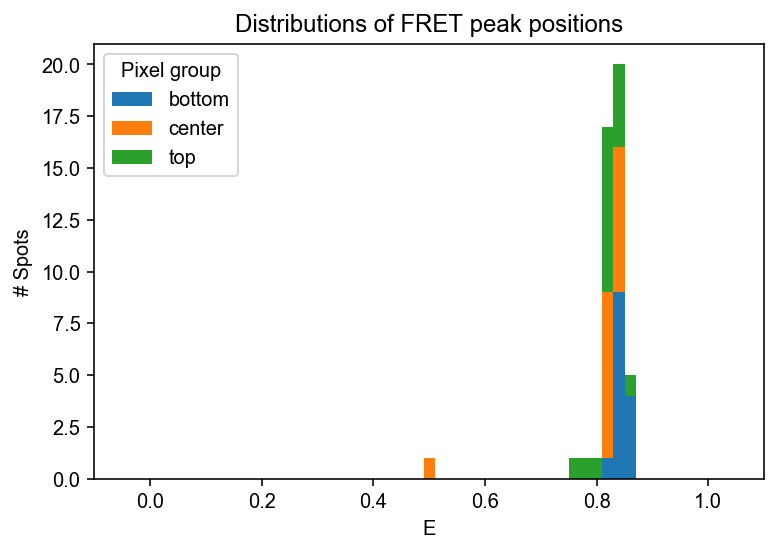

In [71]:
binwidth = 0.02
bins= np.arange(-0.1, 1.1, binwidth) + 0.5*binwidth
labels = sorted(set(FRET_peak.Pixel))
Efret_groups = [np.array(FRET_peak.E[FRET_peak.Pixel == grp]) for grp in labels]

plt.hist(Efret_groups, bins=bins, range=(bins.min(), bins.max()), histtype='bar', stacked=True);
plt.xlabel('E')
plt.ylabel('# Spots')
plt.xlim(-0.1, 1.1)
plt.title('Distributions of FRET peak positions')
plt.legend(labels, title='Pixel group')
print('FRET pop: E mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (FRET_peak.E.mean(), FRET_peak.E.min(), FRET_peak.E.max(), FRET_peak.E.std()))
savefig('FRET_peaks_distributions_grouped.png')

FRET pop: S mean [min, max] = 0.800 [0.771, 0.854], σ = 0.019
Saved: figures/2017-07-21_04_7d_3nM_S_peaks_distributions_grouped.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_S_peaks_distributions_grouped_highres.png


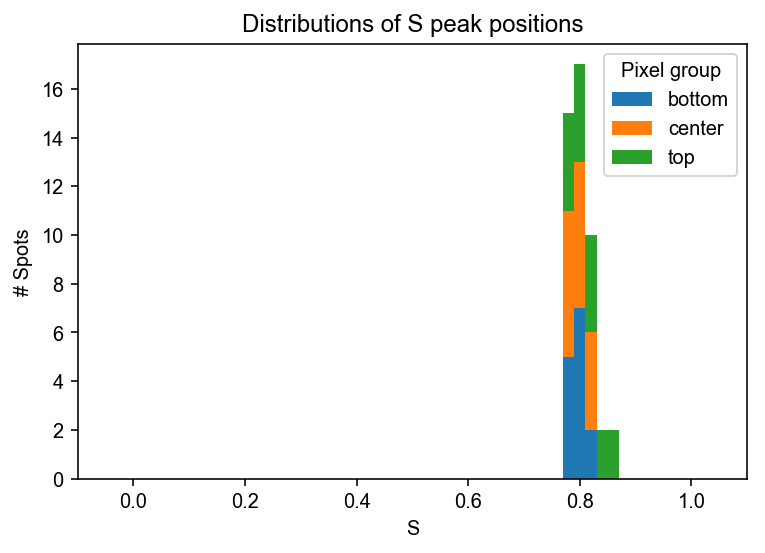

In [72]:
binwidth = 0.02
bins= np.arange(-0.1, 1.1, binwidth) + 0.5*binwidth
labels = sorted(set(FRET_peak.Pixel))
Sfret_groups = [np.array(FRET_peak.S[FRET_peak.Pixel == grp]) for grp in labels]

plt.hist(Sfret_groups, bins=bins, range=(bins.min(), bins.max()), histtype='bar', stacked=True);
plt.xlabel('S')
plt.ylabel('# Spots')
plt.xlim(-0.1, 1.1)
plt.title('Distributions of S peak positions')
plt.legend(labels, title='Pixel group')
print('FRET pop: S mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (FRET_peak.S.mean(), FRET_peak.S.min(), FRET_peak.S.max(), FRET_peak.S.std()))
savefig('S_peaks_distributions_grouped.png')

FRET pop: Su mean [min, max] = 0.502 [0.487, 0.560], σ = 0.013
Saved: figures/2017-07-21_04_7d_3nM_Su_peaks_distributions_grouped.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_Su_peaks_distributions_grouped_highres.png


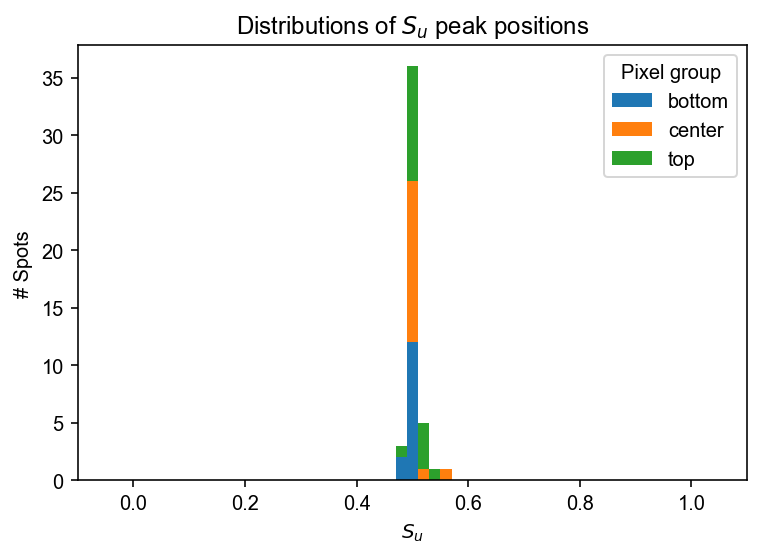

In [73]:
binwidth = 0.02
bins= np.arange(-0.1, 1.1, binwidth) + 0.5*binwidth
labels = sorted(set(FRET_peak.Pixel))
Sufret_groups = [np.array(FRET_peak.Su[FRET_peak.Pixel == grp]) for grp in labels]

plt.hist(Sufret_groups, bins=bins, range=(bins.min(), bins.max()), histtype='bar', stacked=True);
plt.xlabel('$S_u$')
plt.ylabel('# Spots')
plt.xlim(-0.1, 1.1)
plt.title('Distributions of $S_u$ peak positions')
plt.legend(labels, title='Pixel group')
print('FRET pop: Su mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (FRET_peak.Su.mean(), FRET_peak.Su.min(), FRET_peak.Su.max(), FRET_peak.Su.std()))
savefig('Su_peaks_distributions_grouped.png')

In [74]:
num_bursts = FRET_peak.num_bursts
x = FRET_peak.index
y = FRET_peak.E
yerr = np.array(Efret_fitt.query('name == "sigma"')['value']) / np.sqrt(num_bursts)
sort = num_bursts.argsort()

Saved: figures/2017-07-21_04_7d_3nM_E_fit_vs_num_bursts.png
Saved hires: figures/2017-07-21_04_7d_3nM_E_fit_vs_num_bursts_highres.png


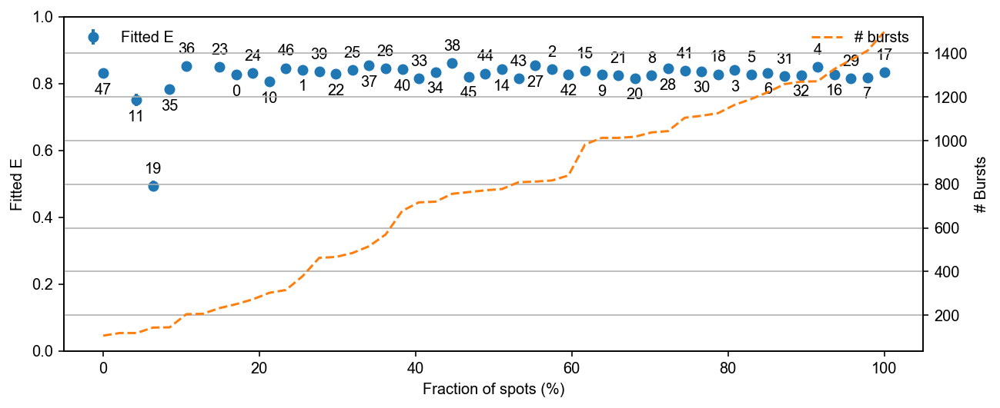

In [75]:
plt.figure(figsize=(10, 4))
x = FRET_peak.index / FRET_peak.index.max() * 100
y = FRET_peak.E
yerr = FRET_peak.E_err
plt.errorbar(x, y.loc[sort], yerr.loc[sort], lw=0, elinewidth=2, marker='o', label='Fitted E')
plt.xlabel('Fraction of spots (%)')
plt.ylabel('Fitted E')
plt.ylim(0, 1)
plt.legend(frameon=False, loc='upper left')
delta = 0.05
for ich, (spot, yi, xi) in enumerate(zip(np.arange(48)[sort], y.loc[sort], x)):
    delta *= -1
    plt.annotate('%d' % spot, (xi, yi + delta), ha='center', va='center')
ax2 = plt.twinx()
ax2.plot(x, num_bursts[sort], color='C1', ls='--', label='# bursts')
ax2.set_ylabel('# Bursts')
ax2.grid(True)
plt.legend(frameon=False, loc='upper right');
savefig('E fit vs num_bursts')

In [76]:
y = np.array(FRET_peak.E).reshape(4, 12)
yerr = np.array(FRET_peak.E_err).reshape(4, 12)
x = np.arange(12)

Saved: figures/2017-07-21_04_7d_3nM_Fitted_E_vs_Pixel_Column.png
Saved hires: figures/2017-07-21_04_7d_3nM_Fitted_E_vs_Pixel_Colum_highres.png


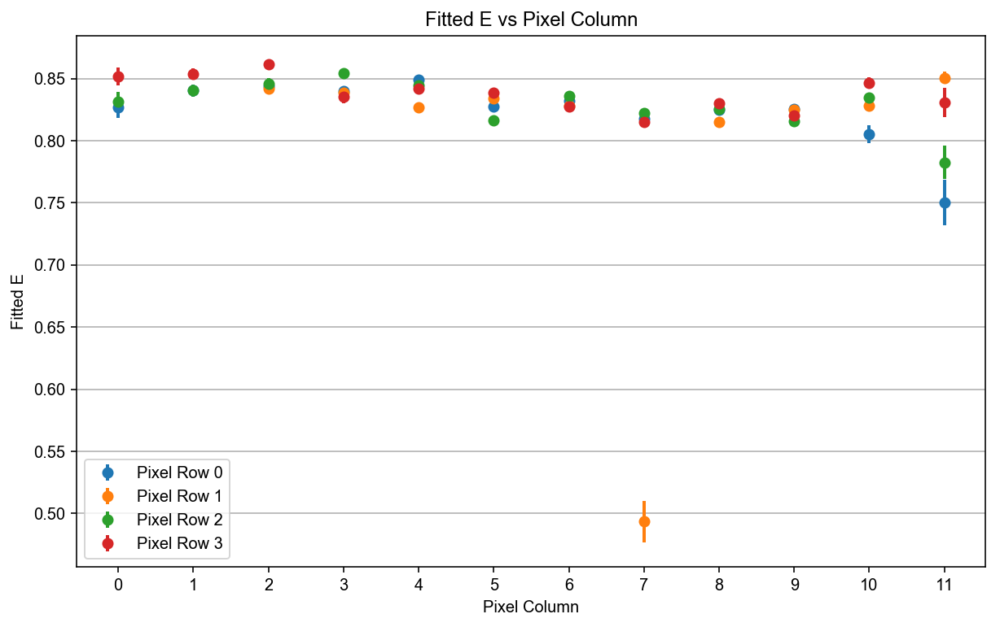

In [77]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6), squeeze=True, sharex=True, sharey=True)
for irow  in range(4):
    ax.errorbar(x, y[irow], yerr[irow], lw=0, elinewidth=2, marker='o', label='Pixel Row %d' % irow)
ax.set_xticks(range(0, 12, 1))
ax.set_ylabel('Fitted E')
ax.set_xlabel('Pixel Column')
plt.legend()
plt.grid(True, axis='y')
plt.title('Fitted E vs Pixel Column')
savefig('Fitted E vs Pixel Column')

(0, 1)

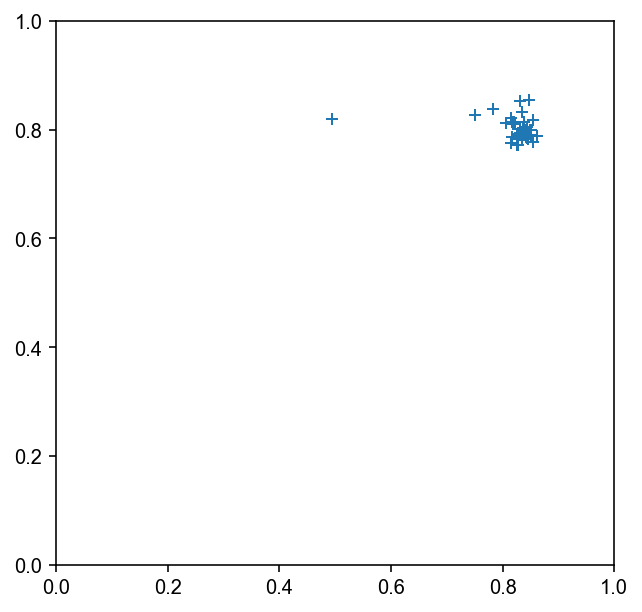

In [78]:
fig, ax = plt.subplots(figsize=(5,5))
ax.plot(FRET_peak.E, FRET_peak.S, lw=0, marker='+', mew=1, label='FRET peak')
#ax.plot(FRET_peak.E, FRET_peak.S, lw=0, marker='o', label='FRET peak')
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)

### D-only population fit

In [79]:
ddo = d.copy()

Deep copy executed.


In [80]:
ddo.burst_search(min_rate_cps=50e3, pax=True, ph_sel=Ph_sel(Dex='Dem', Aex='Dem'))

 - Performing burst search (verbose=False) ... - Fixing  burst data to refer to ph_times_m ... [DONE]
[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]


In [81]:
ds_dox = ddo.select_bursts(select_bursts.size, ph_sel=Ph_sel(Dex='Dem', Aex='Dem'),
                           th1 = 40)
ds_do2 = ds_dox.select_bursts(select_bursts.size, 
                              ph_sel=Ph_sel(Aex='Aem'), naa_aexonly=False,
                              th2=4, th1=-10)

Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(ds_do2.nd, ds_do2.na, ds_do2.naa)]
ds_do2.add(Su=Su)

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


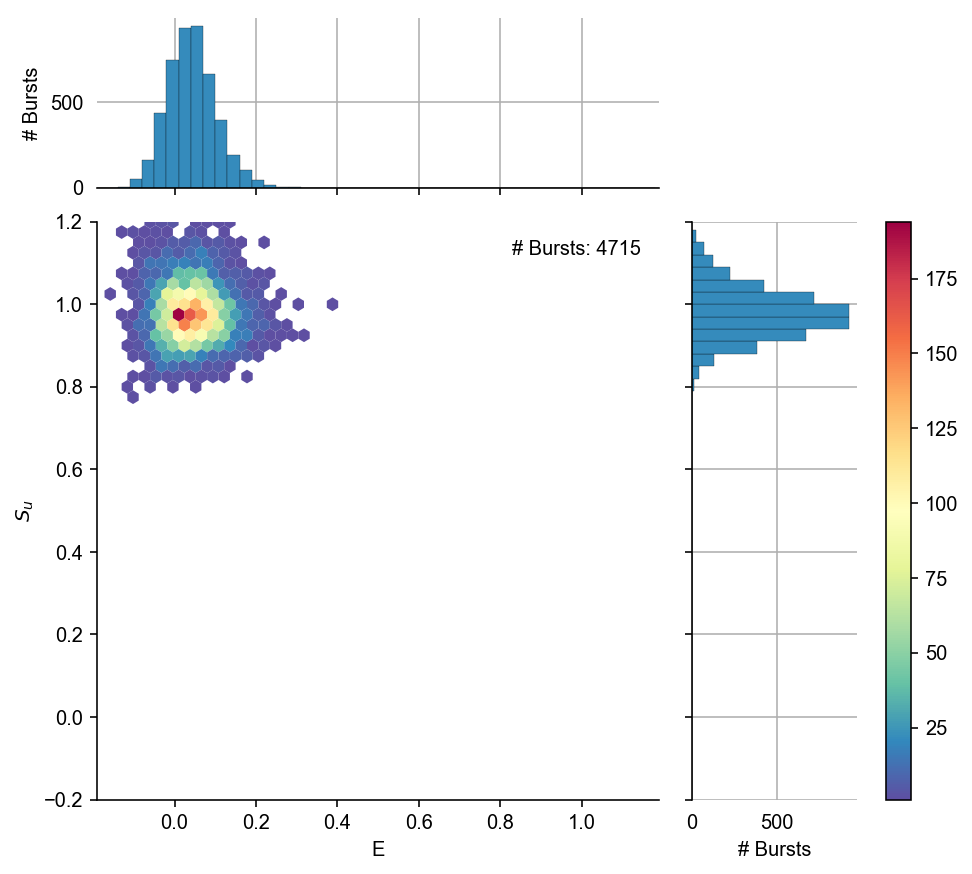

In [82]:
g = alex_jointplot(ds_do2, i=30, S_name='Su', vmax_fret=False, marginal_kws=dict(show_kde=False))
g.ax_joint.set_ylabel('$S_u$')

Saved: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_DonlyBS.png
Saved hires: figures/2017-07-21_04_7d_3nM_48spot_alex_hist_Su_DonlyBS_highres.png


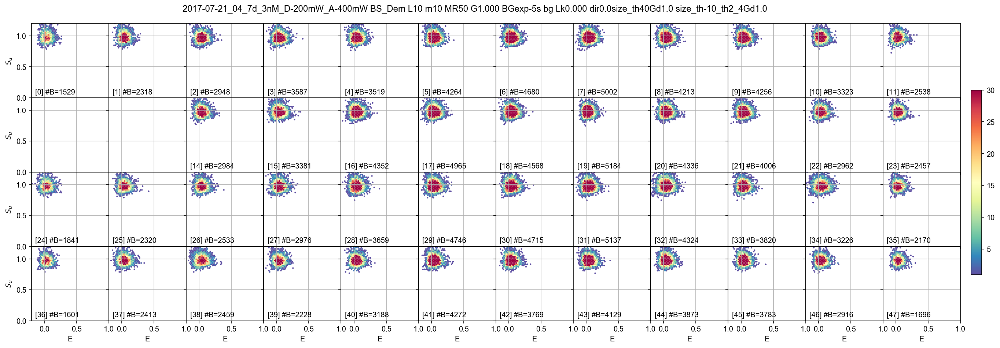

In [83]:
ax = dplot(ds_do2, hexbin_alex, vmax=30, S_name='Su', skip_ch=skip_ch, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$');
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
savefig('48spot alex hist Su DonlyBS')

In [84]:
ds_do = ds_do2

In [85]:
E_fitter = bext.bursts_fitter(ds_do, 'E', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.05, min=-0.2, max=0.4)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.2)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center         0.05     -0.2      0.4     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.2     True    


In [86]:
E_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_DO_pop_-_E_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_DO_pop_-_E_hist_fit_highres.png


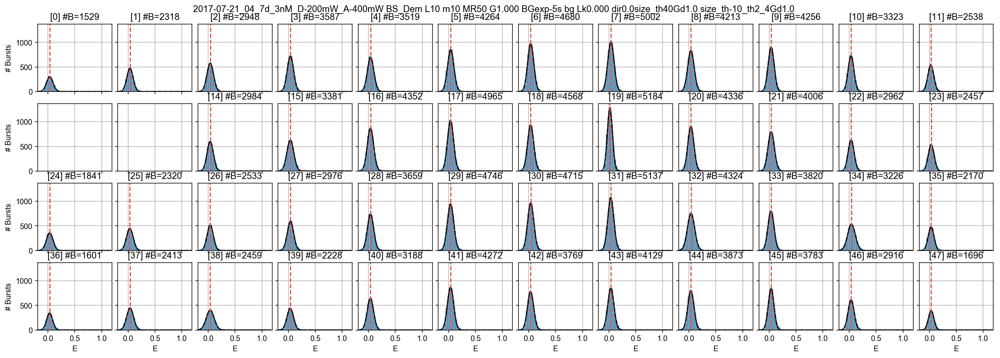

In [87]:
ax = dplot(ds_do, hist_fret, pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('DO pop - E hist fit')

In [88]:
S_fitter = bext.bursts_fitter(ds_do, 'S', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.9, min=0, max=1.1)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.3)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center          0.9        0      1.1     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.3     True    


In [89]:
S_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_DO_pop_-_S_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_DO_pop_-_S_hist_fit_highres.png


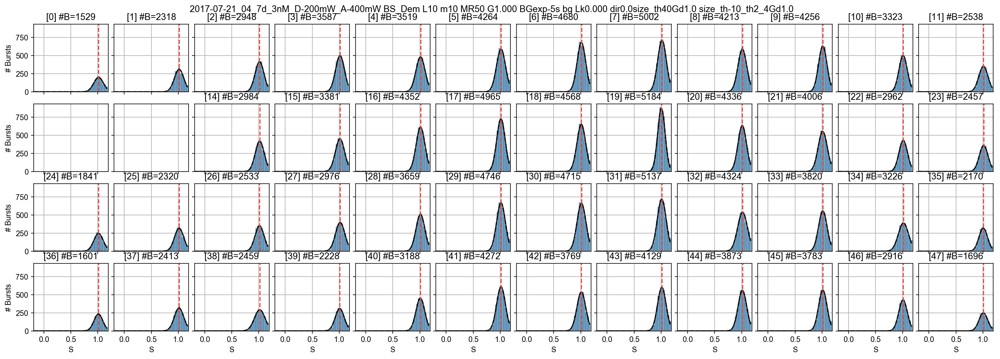

In [90]:
ax = dplot(ds_do, hist_S, pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('DO pop - S hist fit');

In [91]:
Su_fitter = bext.bursts_fitter(ds_do, 'Su', skip_ch=skip_ch)
model = mfit.factory_gaussian()
model.set_param_hint('center', value=0.9, min=0, max=1.2)
model.set_param_hint('sigma', value=0.1, min=0.03, max=0.2)
model.print_param_hints()

Name          Value      Min      Max     Vary    Expr    
amplitude         1     -inf      inf     True    
center          0.9        0      1.2     True    
fwhm            nan     -inf      inf     True    2.3548200*sigma
height          nan     -inf      inf     True    0.3989423*amplitude/max(1.e-15, sigma)
sigma           0.1     0.03      0.2     True    


In [92]:
Su_fitter.fit_histogram(model, pdf=False, method='mealder')

/home/anto/src/FRETBursts/fretbursts/mfit.py:329: RuntimeWarning: invalid value encountered in true_divide
  self.hist_pdf /= self.hist_counts.sum(1)[:, np.newaxis]


Saved: figures/2017-07-21_04_7d_3nM_DO_pop_-_Su_hist_fit.png
Saved hires: figures/2017-07-21_04_7d_3nM_DO_pop_-_Su_hist_fit_highres.png


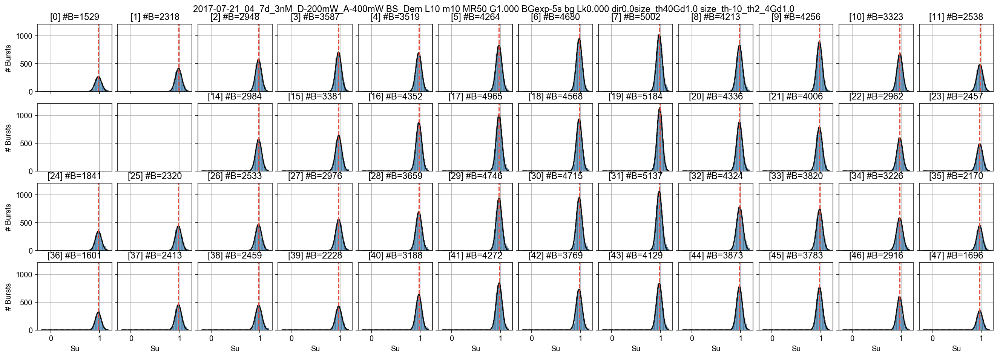

In [93]:
ax = dplot(ds_do, hist_burst_data, data_name='Su', pdf=False, show_model=True, skip_ch=skip_ch);
plt.setp(ax[:, 0], ylabel='# Bursts')
savefig('DO pop - Su hist fit');

### D-only population tidy

In [94]:
Edo_fitg = br.glance(E_fitter.fit_res, var_names='spot')
Sdo_fitg = br.glance(S_fitter.fit_res, var_names='spot')
Sudo_fitg = br.glance(Su_fitter.fit_res, var_names='spot')

In [95]:
Edo_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,2125.169754,49.422552,182.316416,187.802340,225,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,4178.043484,97.163802,213.412020,218.897944,264,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,3443.463071,80.080537,204.517211,210.003136,273,True,Optimization terminated successfully.,2


In [96]:
Sdo_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,1502.874383,34.950567,166.378697,171.864621,233,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,5114.677330,118.945984,222.716497,228.202421,245,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,4388.399170,102.055795,215.671606,221.157530,254,True,Optimization terminated successfully.,2


In [97]:
Sudo_fitg.head(3)

,model,method,num_params,num_data_points,chisqr,redchi,AIC,BIC,num_func_eval,success,message,spot
0,Model(gaussian),Nelder-Mead,3,46,2783.255976,64.726883,194.725826,200.211750,188,True,Optimization terminated successfully.,0
1,Model(gaussian),Nelder-Mead,3,46,5094.558127,118.478096,222.535194,228.021118,225,True,Optimization terminated successfully.,1
2,Model(gaussian),Nelder-Mead,3,46,6231.347806,144.915065,231.800501,237.286425,256,True,Optimization terminated successfully.,2


In [98]:
Edo_fitt = br.tidy(E_fitter.fit_res, var_names='spot')
Sdo_fitt = br.tidy(S_fitter.fit_res, var_names='spot')
Sudo_fitt = br.tidy(Su_fitter.fit_res, var_names='spot')
Edo_fitt.head()

,name,value,min,max,vary,expr,stderr,init_value,spot
0,amplitude,45.922588,-inf,inf,True,None,NaN,1.00,0
1,center,0.035422,-0.200000,0.400000,True,None,NaN,0.05,0
2,fwhm,0.141706,-inf,inf,False,2.3548200*sigma,NaN,NaN,0
3,height,304.443481,-inf,inf,False,"0.3989423*amplitude/max(1.e-15, sigma)",NaN,NaN,0
4,sigma,0.060177,0.030000,0.200000,True,None,NaN,0.10,0


In [99]:
DO_peak = make_ES_fit_dataframe(Edo_fitt, Sdo_fitt, Sudo_fitt, ds_do)

In [100]:
DO_peak.head()

,E,S,Su,num_bursts,E_sigma,S_sigma,Su_sigma,E_err,S_err,Su_err,Pixel
spot,,,,,,,,,,,
0,0.035422,1.013530,0.972242,1529,0.060177,0.089109,0.066911,0.001539,0.002279,0.001711,bottom
1,0.036601,1.014374,0.973968,2318,0.058005,0.086919,0.065782,0.001205,0.001805,0.001366,bottom
2,0.039260,1.013760,0.971013,2948,0.060704,0.082560,0.060536,0.001118,0.001521,0.001115,bottom
3,0.039963,1.014048,0.968349,3587,0.058981,0.082964,0.059372,0.000985,0.001385,0.000991,bottom
4,0.041322,1.014558,0.969716,3519,0.059570,0.084414,0.059384,0.001004,0.001423,0.001001,center


### D-only population plots

DO pop  : E mean [min, max] = 0.037 [0.020, 0.042], σ = 0.004
FRET pop: E mean [min, max] = 0.823 [0.493, 0.861], σ = 0.053
Saved: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_peaks_distributions_grouped.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_peaks_distributions_grouped_highres.png


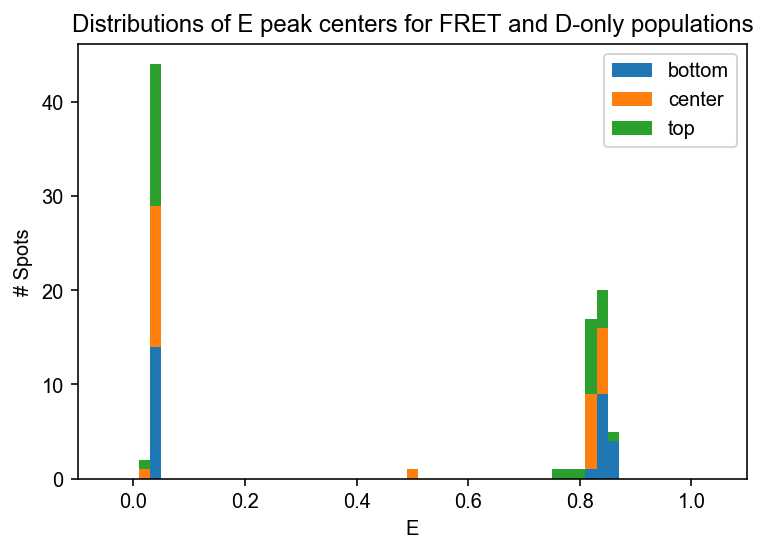

In [101]:
binwidth = 0.02
bins= np.arange(-0.1, 1.1, binwidth) + 0.5*binwidth
labels = sorted(set(DO_peak.Pixel))
Edo_groups = [np.array(DO_peak.E[DO_peak.Pixel == grp]) for grp in labels]

plt.hist(Edo_groups, bins=bins, histtype='bar', range=(bins.min(), bins.max()), stacked=True);
plt.hist(Efret_groups, bins=bins, histtype='bar', range=(bins.min(), bins.max()), stacked=True, color=('C0', 'C1', 'C2'));

plt.xlabel('E')
plt.ylabel('# Spots')
plt.xlim(-0.1, 1.1)
plt.title('Distributions of E peak centers for FRET and D-only populations')
plt.legend(labels)
print('DO pop  : E mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (DO_peak.E.mean(), DO_peak.E.min(), DO_peak.E.max(), DO_peak.E.std()))
print('FRET pop: E mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (FRET_peak.E.mean(), FRET_peak.E.min(), FRET_peak.E.max(), FRET_peak.E.std()))
savefig('FRET_vs_DO_peaks_distributions_grouped.png')

FRET pop: Su mean [min, max] = 0.502 [0.487, 0.560], σ = 0.013
DO      : Su mean [min, max] = 0.973 [0.968, 0.981], σ = 0.002
Saved: figures/2017-07-21_04_7d_3nM_Su_peaks_distributions_grouped.png.png
Saved hires: figures/2017-07-21_04_7d_3nM_Su_peaks_distributions_grouped_highres.png


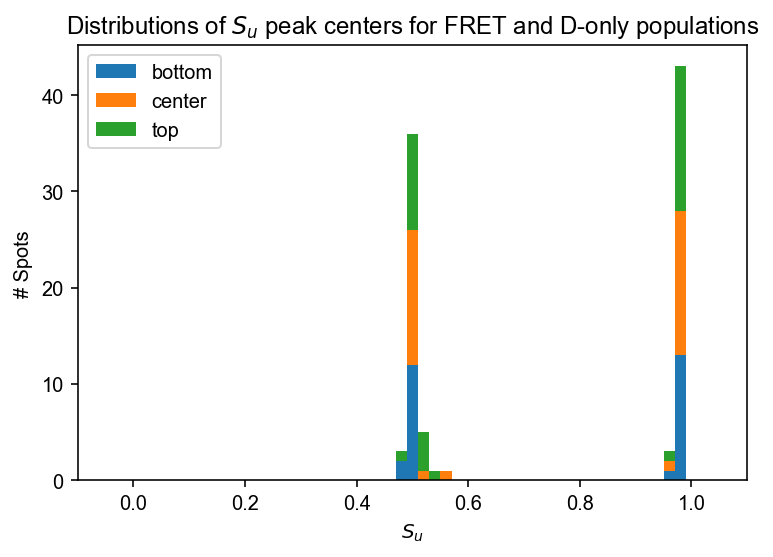

In [102]:
binwidth = 0.02
bins= np.arange(-0.1, 1.1, binwidth) + 0.5*binwidth
labels = sorted(set(DO_peak.Pixel))
Sudo_groups = [np.array(DO_peak.Su[DO_peak.Pixel == grp]) for grp in labels]

plt.hist(Sudo_groups, bins=bins, histtype='bar', range=(bins.min(), bins.max()), stacked=True);
plt.hist(Sufret_groups, bins=bins, histtype='bar', range=(bins.min(), bins.max()), stacked=True, color=('C0', 'C1', 'C2'));
plt.xlabel('$S_u$')
plt.ylabel('# Spots')
plt.xlim(-0.1, 1.1)
plt.title('Distributions of $S_u$ peak centers for FRET and D-only populations')
plt.legend(labels)
print('FRET pop: Su mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (FRET_peak.Su.mean(), FRET_peak.Su.min(), FRET_peak.Su.max(), FRET_peak.Su.std()))
print('DO      : Su mean [min, max] = %5.3f [%5.3f, %5.3f], σ = %5.3f' % 
      (DO_peak.Su.mean(), DO_peak.Su.min(), DO_peak.Su.max(), DO_peak.Su.std()))
savefig('Su_peaks_distributions_grouped.png')

Saved: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_fitted_Epr-S_peak_position.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_fitted_Epr-S_peak_positio_highres.png


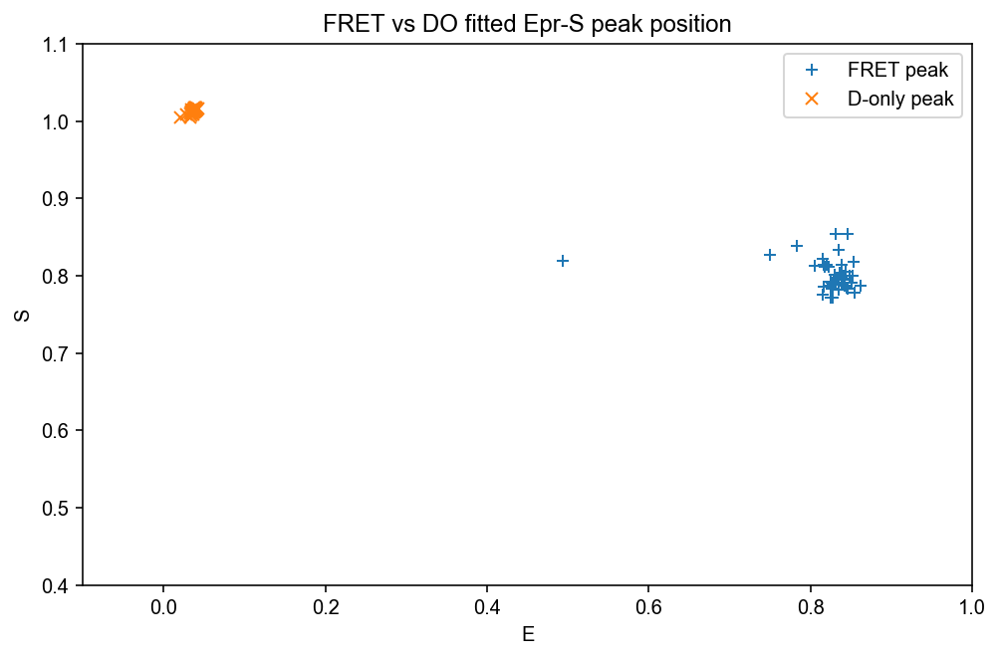

In [103]:
fig, ax = plt.subplots(figsize=(8, 5))
ax.plot(FRET_peak.E, FRET_peak.S, lw=0, marker='+', mew=1, label='FRET peak')
ax.plot(DO_peak.E, DO_peak.S, lw=0, marker='x', mew=1, label='D-only peak')
ax.set_xlim(-0.1, 1)
ax.set_ylim(0.4, 1.1)
plt.setp(ax, xlabel='E', ylabel='S')
plt.title('FRET vs DO fitted Epr-S peak position')
plt.legend()
savefig('FRET vs DO fitted Epr-S peak position')

Saved: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_fitted_Epr-Su_peak_position.png
Saved hires: figures/2017-07-21_04_7d_3nM_FRET_vs_DO_fitted_Epr-Su_peak_positio_highres.png


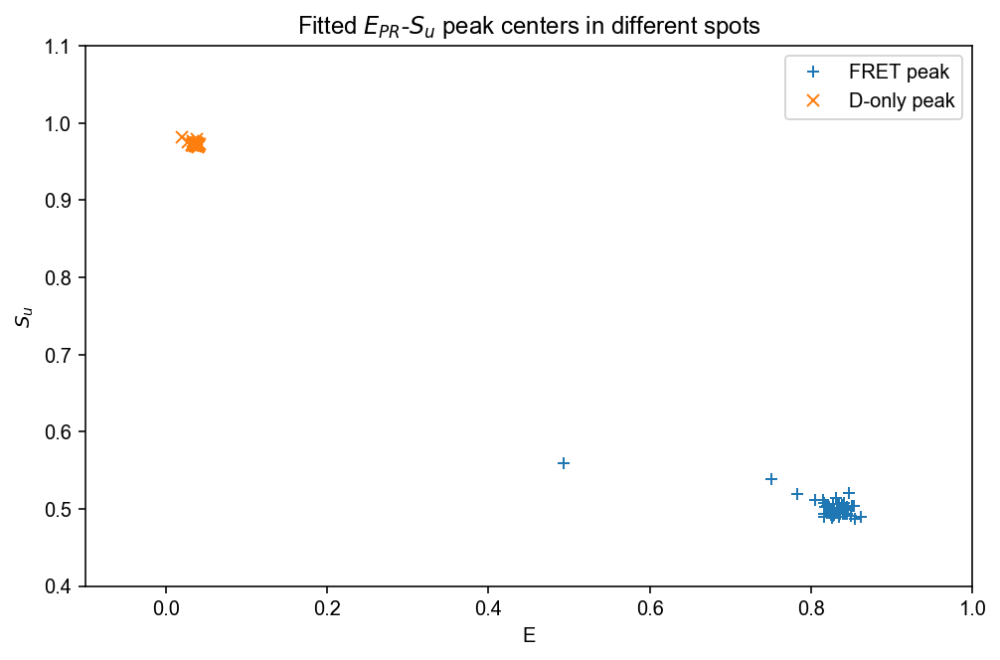

In [104]:
fig, ax = plt.subplots(figsize=(8, 5))
ax.plot(FRET_peak.E, FRET_peak.Su, lw=0, marker='+', mew=1, label='FRET peak')
ax.plot(DO_peak.E, DO_peak.Su, lw=0, marker='x', mew=1, label='D-only peak')
ax.set_xlim(-0.1, 1)
ax.set_ylim(0.4, 1.1)
plt.setp(ax, xlabel='E', ylabel='$S_u$')
plt.title('Fitted $E_{PR}$-$S_u$ peak centers in different spots')
plt.legend()
savefig('FRET vs DO fitted Epr-Su peak position')

# Global plots

In [105]:
def figure48(figsize=(18, 6), annotate=True, 
             text_fmt='%d', text_x=0.85, text_y=0.9, text_data=spotsh, text_va='top', text_ha='right'):
    fig, axes = plt.subplots(4, 12, figsize=figsize, sharex=True, sharey=True)
    plt.subplots_adjust(hspace=0, wspace=0)
    if annotate:
        for irow, axrow in enumerate(axes):
            for icol, ax in enumerate(axrow):
                ax.text(text_x, text_y, text_fmt % text_data[irow, icol], 
                        transform=ax.transAxes, ha=text_ha, va=text_va)
    return fig, axes

In [106]:
err_kws = dict(capsize=6, capthick=1.5, marker='o', ms=6)

In [107]:
x = np.array(FRET_peak.E).reshape(4, 12)
xerr = np.array(FRET_peak.E_sigma).reshape(4, 12)
y = np.array(FRET_peak.Su).reshape(4, 12)
yerr = np.array(FRET_peak.Su_sigma).reshape(4, 12)
xmean = np.nanmean(x)
ymean = np.nanmean(y)
delta = np.max([np.nanmax(yerr), np.nanmax(xerr)])*1.5

Saved: figures/2017-07-21_04_7d_3nM_48-spot_Epr-Su_peak_position_deviation_from_mean.png
Saved hires: figures/2017-07-21_04_7d_3nM_48-spot_Epr-Su_peak_position_deviation_from_mea_highres.png


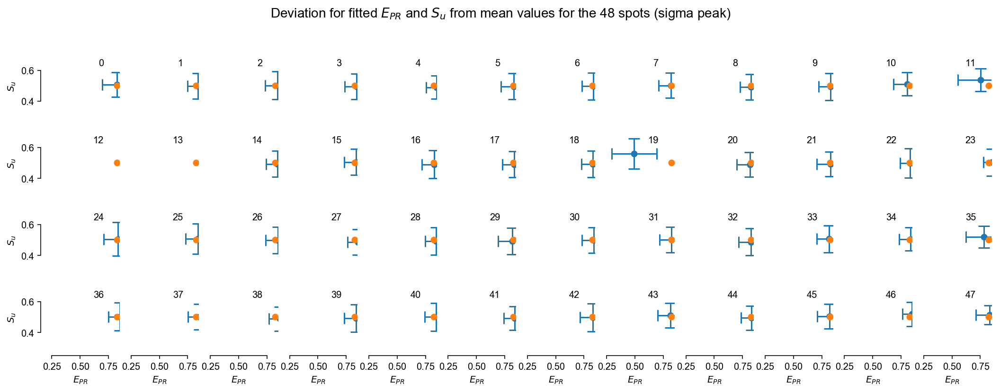

In [108]:
fig, axes = figure48(text_x=0.80, text_y=0.85, text_ha='right')
for irow, axrow in enumerate(axes):
    for icol, ax in enumerate(axrow):
        ax.errorbar(x[irow, icol], y[irow, icol], xerr=xerr[irow,icol], yerr=yerr[irow,icol], **err_kws)
        ax.plot(xmean, ymean, marker='o', zorder=10)
        sns.despine(left=True, bottom=True)
#plt.setp(axes[0], xlim=(np.round(xmean - delta, 1), np.round(xmean + delta, 1)));
#plt.setp(axes[:,0], ylim=(ymean - delta, ymean + delta));
plt.setp(axes[0], xlim=(0.15, 0.85));
plt.setp(axes[:,0], ylim=(0.25, 0.75));
plt.setp(axes[-1], xlabel='$E_{PR}$')
plt.setp(axes[:, 0], ylabel='$S_u$');
for ax in axes[-1]:
    sns.despine(bottom=False, left=True, trim=True, ax=ax)
for ax in axes[:, 0]:
    sns.despine(left=False, bottom=True, trim=True, ax=ax)
sns.despine(left=False, bottom=False, trim=True, ax=axes[-1,0])
for ax in axes[:-1].ravel():
    ax.tick_params(bottom=False)
for ax in axes[:, 1:].ravel():
    ax.tick_params(left=False)
plt.suptitle('Deviation for fitted $E_{PR}$ and $S_u$ from mean values for the 48 spots (sigma peak)', fontsize=14, va='top');
savefig('48-spot Epr-Su peak position deviation from mean')

# Calibration

For convenience we reporte the formula for the relative-$\gamma$ factor $\chi_{ch}$
and the expression of $E$ as a function of $E_{PR}$:

$$
\chi_{ch} = \frac{\frac{1}{\langle E_{PR\,ch} \rangle_{ch}} - 1}{\frac{1}{E_{PR\,ch}} - 1} 
$$

$$
E = \frac{1}{1 + \gamma \left( \frac{1}{E_{PR}} - 1 \right)}
$$

In [109]:
chi_ch = (1/FRET_peak.E.mean() - 1) / (1/FRET_peak.E - 1)
E_corr = 1 / (1 + chi_ch * (1/FRET_peak.E - 1))
E_corr.head()

spot
0    0.82319
1    0.82319
2    0.82319
3    0.82319
4    0.82319
Name: E, dtype: float64

In [110]:
assert (E_corr.max() - E_corr.min()) < 1e-9  # Test that E_corr are all "equal"

In [111]:
ds_fret.num_bursts

array([ 251,  379,  817, 1163, 1271, 1190, 1221, 1411, 1037, 1012,  303,
        119,  119,  207,  778,  982, 1327, 1497, 1125,  144, 1017, 1012,
        467,  233,  273,  485,  570,  812, 1043, 1369, 1113, 1258, 1269,
        717,  720,  145,  205,  516,  756,  463,  678, 1104,  840,  809,
        772,  764,  316,  107])

In [112]:
ds_fret.chi_ch = np.ones(48)

In [113]:
bursts0 = bext.burst_data(ds_fret)
bursts0.shape

(36186, 13)

In [114]:
ds_fret.chi_ch = chi_ch

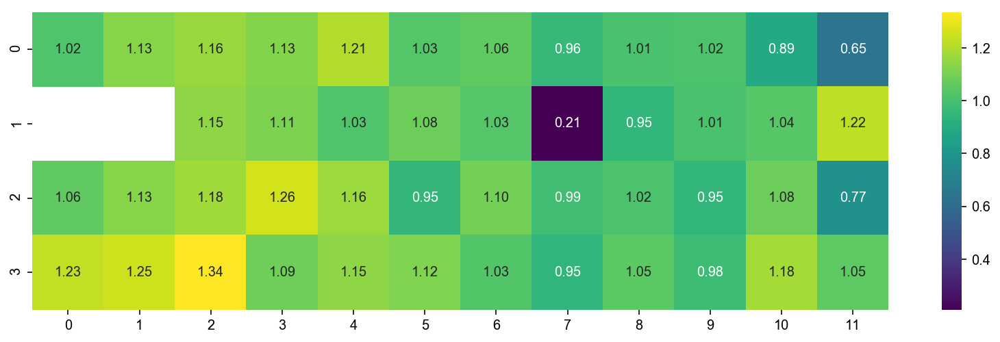

In [115]:
heatmap48(chi_ch, annot=True, fmt='.2f')

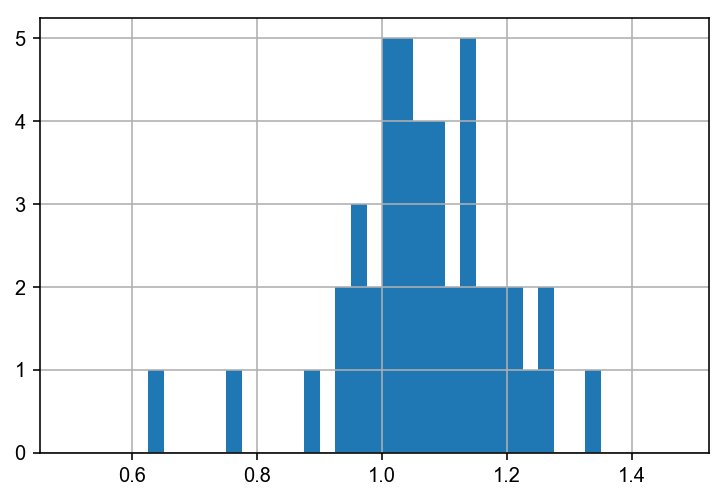

In [116]:
chi_ch.hist(bins=np.arange(0.5, 1.5, 0.025))

In [117]:
bursts = bext.burst_data(ds_fret)
bursts.shape

(36186, 13)

Saved: figures/2017-07-21_04_7d_3nM_48-spot_calibration.png
Saved hires: figures/2017-07-21_04_7d_3nM_48-spot_calibratio_highres.png


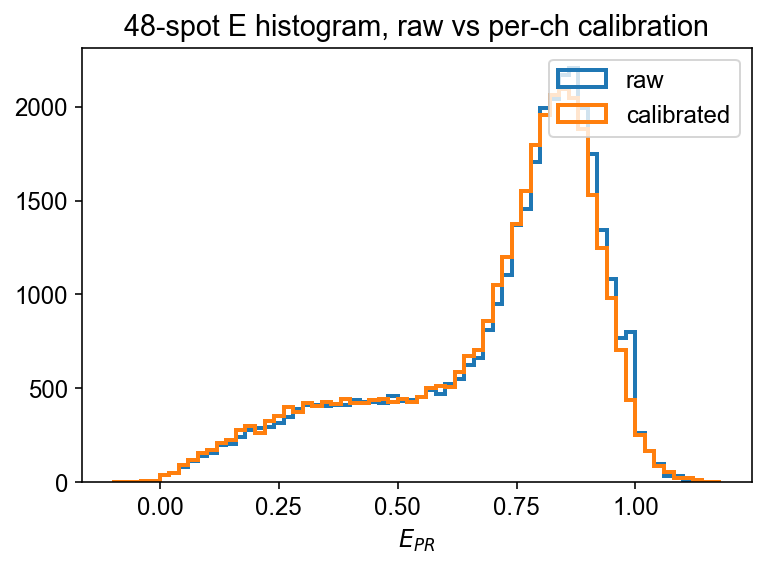

In [118]:
plt.rcParams['font.size'] = 12
kw = dict(bins=np.arange(-0.1,1.2, 0.02), histtype='step', lw=2, range=(-0.1, 1.1))
plt.hist(bursts0.E, label='raw', **kw);
plt.hist(bursts.E, label='calibrated', **kw);
plt.legend();
plt.title('48-spot E histogram, raw vs per-ch calibration');
plt.xlabel('$E_{PR}$')
savefig('48-spot calibration')
plt.rcParams['font.size'] = 14

In [119]:
bursts.head()

,E,S,na,naa,nar,nd,nda,nt,size_raw,t_start,t_stop,width_ms,spot
0,0.625145,0.771698,20.569088,30.303205,20.569088,12.791833,11.288891,74.953017,102,0.970719,0.971876,1.156975,0
1,0.887426,0.926386,20.071096,21.868350,20.071096,3.700206,1.270854,46.910506,70,1.153909,1.154897,0.987687,0
2,0.825497,0.939969,20.989213,22.613059,20.989213,2.552041,6.110686,52.264999,76,1.385077,1.386092,1.015300,0
3,0.940674,0.719630,24.828413,35.111723,24.828413,-0.738923,3.796151,62.997364,88,1.977665,1.978735,1.069525,0
4,0.764560,0.774347,21.849468,30.177366,21.849468,8.299175,4.837335,65.163343,90,2.484496,2.485559,1.062425,0


In [120]:
ich = 33
chi_ch[ich]

0.95177434674237704

In [121]:
ds_fret.chi_ch = np.ones(48)

In [122]:
E0 = ds_fret.E[ich]

In [123]:
ds_fret.chi_ch = chi_ch

In [124]:
E = ds_fret.E[ich]

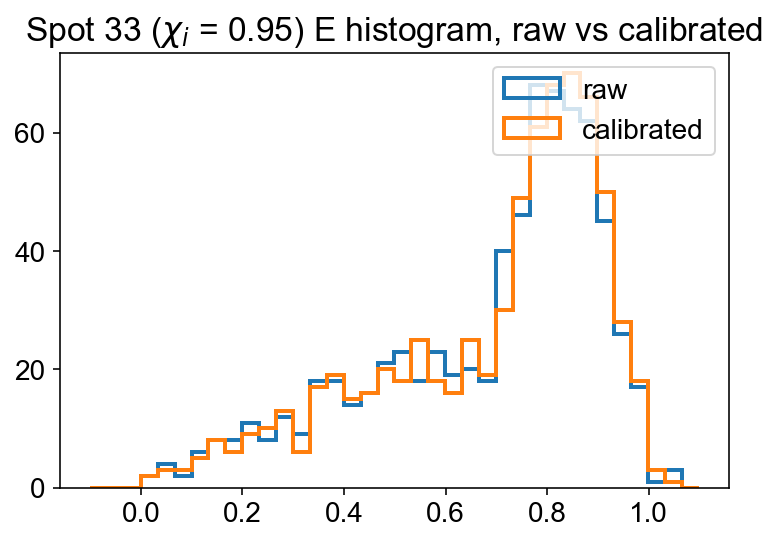

In [125]:
kw = dict(bins=np.arange(-0.1,1.1, 0.0333), histtype='step', lw=2)
plt.hist(E0, label='raw', **kw);
plt.hist(E, label='calibrated', **kw);
plt.legend();
plt.title('Spot %d ($\chi_i$ = %.2f) E histogram, raw vs calibrated' % (ich, chi_ch[ich]));

In [126]:
ich

33

In [127]:
E0i = bursts0.E.loc[bursts0.spot == ich]
Ei = bursts.E.loc[bursts.spot == ich]

In [128]:
E0a = bursts0.E.loc[~pd.isnull(bursts0.E)]
Ea = bursts.E.loc[~pd.isnull(bursts.E)]

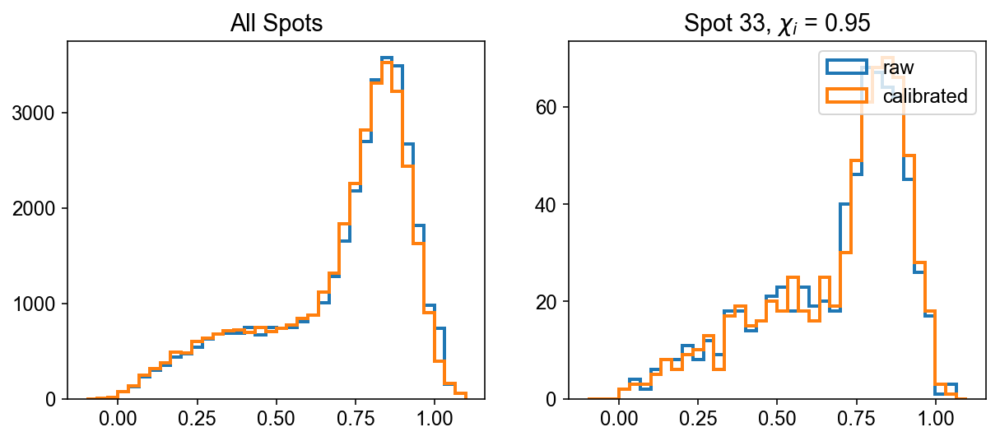

In [129]:
plt.rcParams['font.size'] = 12
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 4))
kw = dict(bins=np.arange(-0.1,1.1, 0.0333), histtype='step', lw=2)
ax0.hist(E0a, label='raw', **kw);
ax0.hist(Ea, label='calibrated', **kw);

ax1.hist(E0i, label='raw', **kw);
ax1.hist(Ei, label='calibrated', **kw);
ax1.legend();
ax1.set_title('Spot %d, $\chi_i$ = %.2f' % (ich, chi_ch[ich]));
ax0.set_title('All Spots');

ax1.set_title('Spot %d, $\chi_i$ = %.2f' % (ich, chi_ch[ich]));
plt.rcParams['font.size'] = 14

In [130]:
(bursts.spot == ich).sum()

717

In [131]:
bursts.spot.shape

(36186,)

In [132]:
bursts0.E.loc[bursts.spot == ich].shape

(717,)

In [133]:
E.shape, bursts.E.loc[bursts.spot == ich].shape

((717,), (717,))

In [134]:
bursts.sample(10).sort_index()

,E,S,na,naa,nar,nd,nda,nt,size_raw,t_start,t_stop,width_ms,spot
1545,0.660246,0.945802,25.174395,27.359324,25.174395,7.031886,15.984400,75.550005,109,12.830462,12.831727,1.265075,3
2019,0.908882,0.820448,19.194864,23.816720,19.194864,2.872795,0.546218,46.430597,59,108.336286,108.337011,0.725487,3
4092,0.376020,0.631648,17.431640,44.465932,17.431640,29.482345,26.566335,117.946253,168,28.485648,28.487672,2.024100,5
10863,0.955312,0.937649,19.652499,21.020472,19.652499,2.782506,-1.178340,42.277138,59,83.005447,83.006301,0.854675,14
13051,0.766872,0.645831,19.256071,33.026130,19.256071,12.522871,-1.112251,63.692821,82,137.217892,137.218931,1.038863,16
18251,0.873670,0.985475,21.639509,22.004580,21.639509,5.172638,1.014558,49.831284,58,315.802814,315.803602,0.787612,21
30207,0.898380,0.674126,23.527662,36.187508,23.527662,2.603513,1.382291,63.700973,78,284.036741,284.037778,1.037313,38
35801,0.581153,0.778535,26.090812,38.861793,26.090812,12.261508,19.509530,96.723642,123,17.828628,17.830001,1.373187,46
35834,0.735967,0.983414,24.899908,25.470537,24.899908,4.544929,10.548109,65.463484,86,32.244719,32.245853,1.133463,46
36102,0.812241,0.892695,36.760782,42.201011,36.760782,7.160960,8.951667,95.074419,118,32.561625,32.563012,1.387175,47


In [135]:
bursts.t_start.max()

547.22027002499999

# Collapse

In [136]:
df = d.fuse_bursts(ms=0)

 - - - - - CHANNEL  1 - - - - 
 --> END Fused 39947 bursts (33.2%, 15 iter)

 - - - - - CHANNEL  2 - - - - 
 --> END Fused 41266 bursts (33.3%, 16 iter)

 - - - - - CHANNEL  3 - - - - 
 --> END Fused 45177 bursts (33.6%, 15 iter)

 - - - - - CHANNEL  4 - - - - 
 --> END Fused 55178 bursts (34.9%, 15 iter)

 - - - - - CHANNEL  5 - - - - 
 --> END Fused 51654 bursts (34.3%, 17 iter)

 - - - - - CHANNEL  6 - - - - 
 --> END Fused 59893 bursts (35.4%, 16 iter)

 - - - - - CHANNEL  7 - - - - 
 --> END Fused 57384 bursts (35.1%, 18 iter)

 - - - - - CHANNEL  8 - - - - 
 --> END Fused 79925 bursts (36.6%, 19 iter)

 - - - - - CHANNEL  9 - - - - 
 --> END Fused 56605 bursts (34.5%, 15 iter)

 - - - - - CHANNEL 10 - - - - 
 --> END Fused 44941 bursts (33.4%, 15 iter)

 - - - - - CHANNEL 11 - - - - 
 --> END Fused 31892 bursts (31.8%, 14 iter)

 - - - - - CHANNEL 12 - - - - 
 --> END Fused 26878 bursts (31.5%, 12 iter)

 - - - - - CHANNEL 13 - - - - 
 --> END Fused 7052 bursts (29.1%, 9 iter)

 

In [137]:
dc = d.collapse(update_gamma=False, skip_ch=skip_ch)  ## check that chi_ch is set to 1 here

In [138]:
d.num_bursts.sum()

6918627

In [139]:
def sel_raw_naa(d, ich=0, th1=20, th2=np.inf, gamma=1., beta=1., donor_ref=True):
    assert th1 <= th2, 'th1 (%.2f) must be <= of th2 (%.2f)' % (th1, th2)
    kws = dict(ich=ich, gamma=gamma, beta=beta, donor_ref=donor_ref)
    naa_term = d.naa[ich]
    bursts_mask = (naa_term >= th1) * (naa_term <= th2)
    return bursts_mask, ''

def sel_ndex_na(d, ich=0, th1=20, th2=np.inf, gamma=1):
    assert th1 <= th2, 'th1 (%.2f) must be <= of th2 (%.2f)' % (th1, th2)
    size = d.nd[ich] + d.nda[ich] + d.na[ich] / gamma
    bursts_mask = (size >= th1) * (size <= th2)
    return bursts_mask, ''

In [140]:
naa_sel_kws = dict(ph_sel=Ph_sel(Aex='Aem'), gamma=1,
                   na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d._burst_sizes_pax_formula(**naa_sel_kws))

<IPython.core.display.Math object>

In [141]:
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='Dem'), gamma=0.5,
                    na_comp=True, naa_comp=False, naa_aexonly=False)

Math(d._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

In [142]:
dcs_th1 = d.select_bursts(select_bursts.size, th1=10, **naa_sel_kws)
dcs_th2 = dcs_th1.select_bursts(select_bursts.size, th1=20, **size_sel_kws)
dcs_th = dcs_th2.collapse(update_gamma=False, skip_ch=skip_ch)

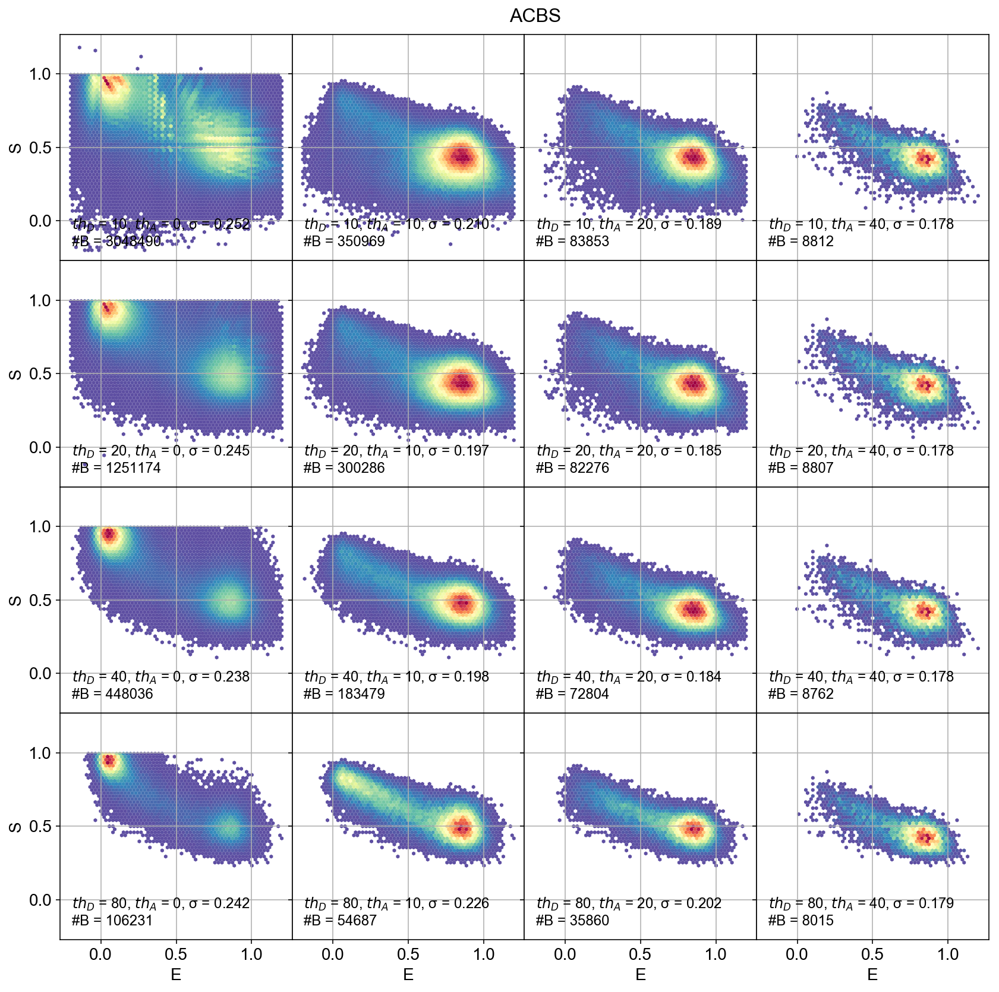

In [143]:
Th = (10, 20, 40, 80)
Th_naa = np.array((0, 10, 20, 40)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        dcs_th1 = d.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        dcs_th2 = dcs_th1.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        dcs_th = dcs_th2.collapse(update_gamma=False, skip_ch=skip_ch)
        Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs_th.nd, dcs_th.na, dcs_th.naa)]
        dcs_th.add(Su=Su)
        E = dcs_th.E[0]
        E_std = E[E > 0.2].std()
        dplot(dcs_th, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
        ax.text(0.05, 0.05, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, dcs_th.num_bursts), 
                va='bottom', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.5, 0.89, 'ACBS', transform=fig.transFigure, fontsize=16);

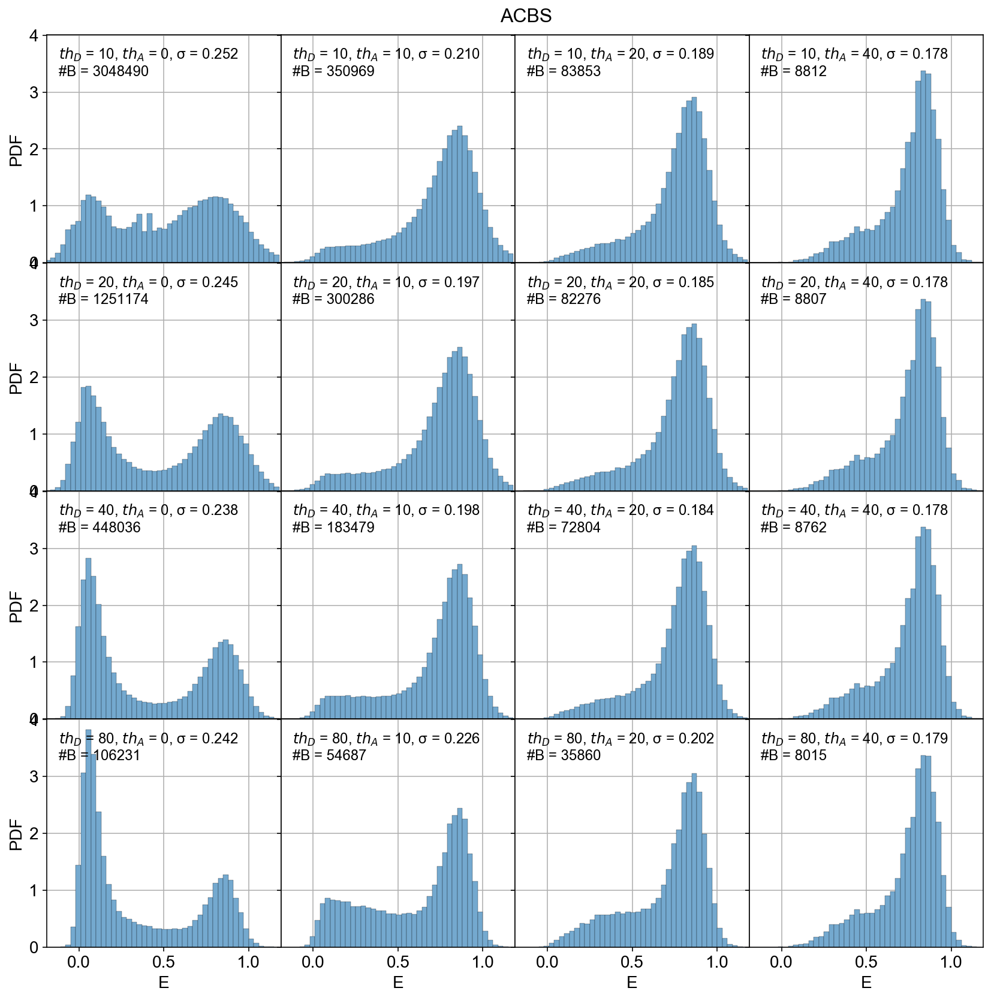

In [144]:
Th = (10, 20, 40, 80)
Th_naa = np.array((0, 10, 20, 40)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        dcs_th1 = d.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        dcs_th2 = dcs_th1.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        dcs_th = dcs_th2.collapse(update_gamma=False, skip_ch=skip_ch)
        dplot(dcs_th, hist_fret, ax=ax)
        E = dcs_th.E[0]
        E_std = E[E > 0.2].std()
        ax.text(0.05, 0.95, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, dcs_th.num_bursts), 
                va='top', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.5, 0.89, 'ACBS', transform=fig.transFigure, fontsize=16)

In [145]:
d2 = bext.burst_search_and_gate(d, min_rate_cps=(50e3, 25e3))

Deep copy executed.
Deep copy executed.
Deep copy executed.
 - Performing burst search (verbose=False) ... - Fixing  burst data to refer to ph_times_m ... [DONE]
[DONE]
 - Calculating burst periods ...[DONE]
 - Performing burst search (verbose=False) ... - Fixing  burst data to refer to ph_times_m ... [DONE]
[DONE]
 - Calculating burst periods ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]


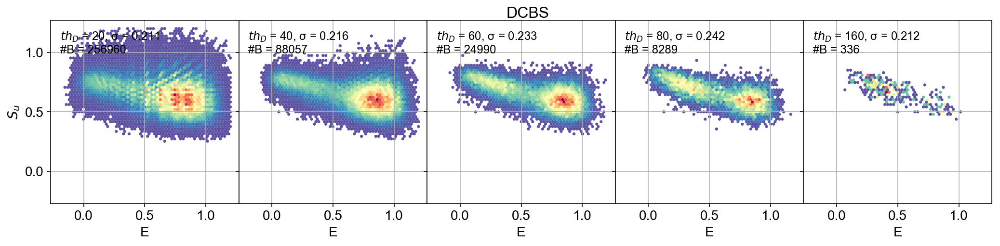

In [146]:
Th = (20, 40, 60, 80, 160)
fig, AX = plt.subplots(1, len(Th), figsize=(3.5*len(Th), 3.5), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    ax = AX[irow]
    dcs_th2 = d2.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
    dcs_th = dcs_th2.collapse(update_gamma=False, skip_ch=skip_ch)
    Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs_th.nd, dcs_th.na, dcs_th.naa)]
    dcs_th.add(Su=Su)
    dplot(dcs_th, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
    E = dcs_th.E[0]
    E_std = E[E > 0.2].std()
    ax.text(0.05, 0.95, '$th_D$ = %d, σ = %.3f\n#B = %d' % (th, E_std, dcs_th.num_bursts), va='top', ha='left',
            transform=ax.transAxes, fontsize=12)
    ax.set_title('')
plt.setp(AX[1:], ylabel='')
AX[0].set_ylabel('$S_u$')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.5, 0.89, 'DCBS', transform=fig.transFigure, fontsize=16);

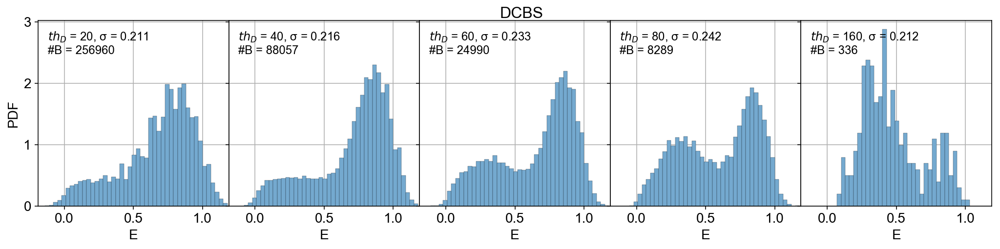

In [147]:
Th = (20, 40, 60, 80, 160)
fig, AX = plt.subplots(1, len(Th), figsize=(3.5*len(Th), 3.5), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    ax = AX[irow]
    dcs_th2 = d2.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
    dcs_th = dcs_th2.collapse(update_gamma=False, skip_ch=skip_ch)
    dplot(dcs_th, hist_fret, ax=ax)
    E = dcs_th.E[0]
    E_std = E[E > 0.2].std()
    ax.text(0.05, 0.95, '$th_D$ = %d, σ = %.3f\n#B = %d' % (th, E_std, dcs_th.num_bursts), va='top', ha='left',
            transform=ax.transAxes, fontsize=12)
    ax.set_title('')
plt.setp(AX[1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.5, 0.89, 'DCBS', transform=fig.transFigure, fontsize=16);

In [148]:
dc = d.collapse(update_gamma=False, skip_ch=skip_ch)

In [149]:
size_Dex = 80
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='Dem'), gamma=0.5,
                    na_comp=True, naa_comp=False, naa_aexonly=False)
dcs = dc.select_bursts(select_bursts.size, th1=size_Dex, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs.nd, dcs.na, dcs.naa)]
dcs.add(Su=Su)
Math(d._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

In [150]:
size_Aex = 25
naa_sel_kws = dict(ph_sel=Ph_sel(Aex='Aem'), gamma=0.5,
                   na_comp=False, naa_comp=False, naa_aexonly=False)
dcss = dcs.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcss.nd, dcss.na, dcss.naa)]
dcss.add(Su=Su)
Math(d._burst_sizes_pax_formula(**naa_sel_kws))

<IPython.core.display.Math object>

In [151]:
dcs1 = dcss.select_bursts(select_bursts.time, time_s1=200)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs1.nd, dcs1.na, dcs1.naa)]
dcs1.add(Su=Su)

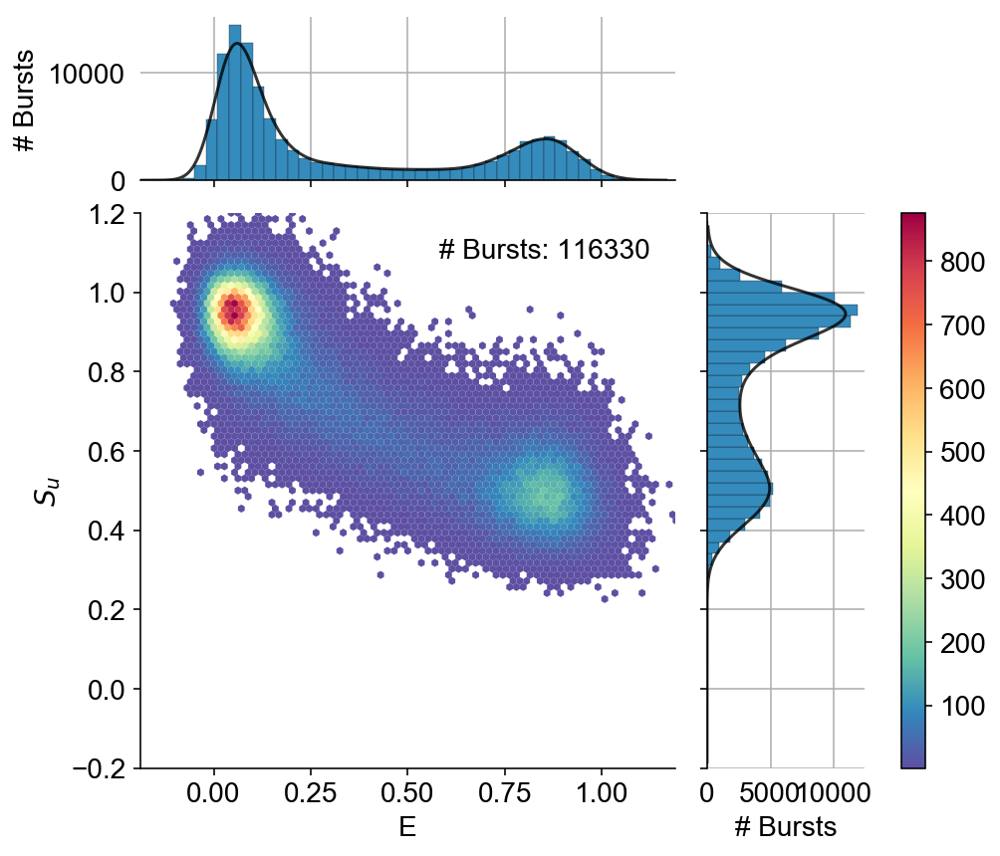

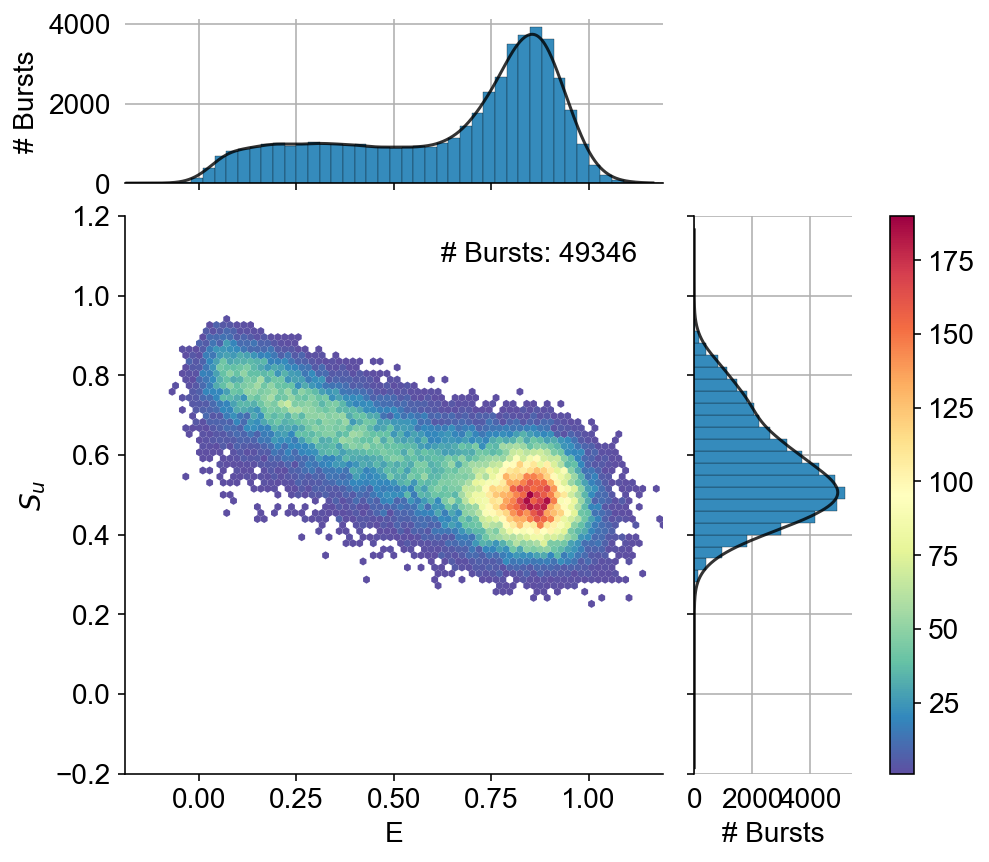

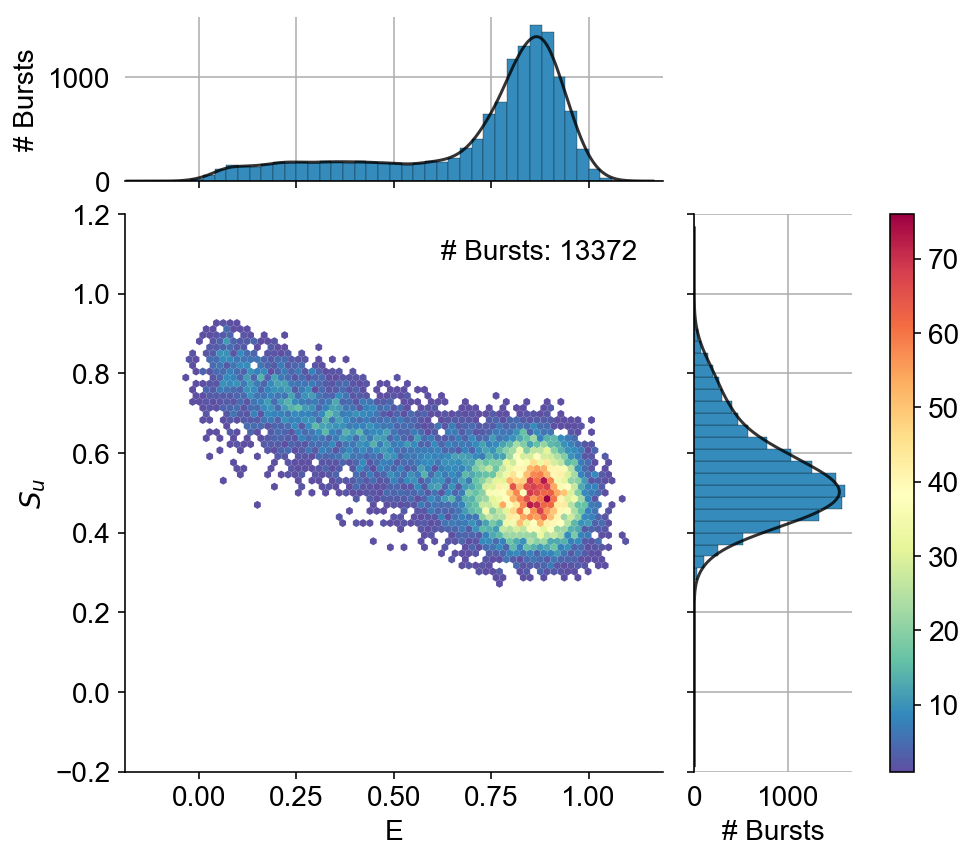

In [152]:
g = alex_jointplot(dcs, S_name='Su', vmax_fret=False, gridsize=80)
g.ax_joint.set_ylabel('$S_u$');
g = alex_jointplot(dcss, S_name='Su', vmax_fret=False, gridsize=80)
g.ax_joint.set_ylabel('$S_u$');
g = alex_jointplot(dcs1, S_name='Su', vmax_fret=False, gridsize=80)
g.ax_joint.set_ylabel('$S_u$');

In [153]:
dcs1 = dcss.select_bursts(select_bursts.time, time_s1=350)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs1.nd, dcs1.na, dcs1.naa)]
dcs1.add(Su=Su)

In [154]:
d.time_max

547.2213699875

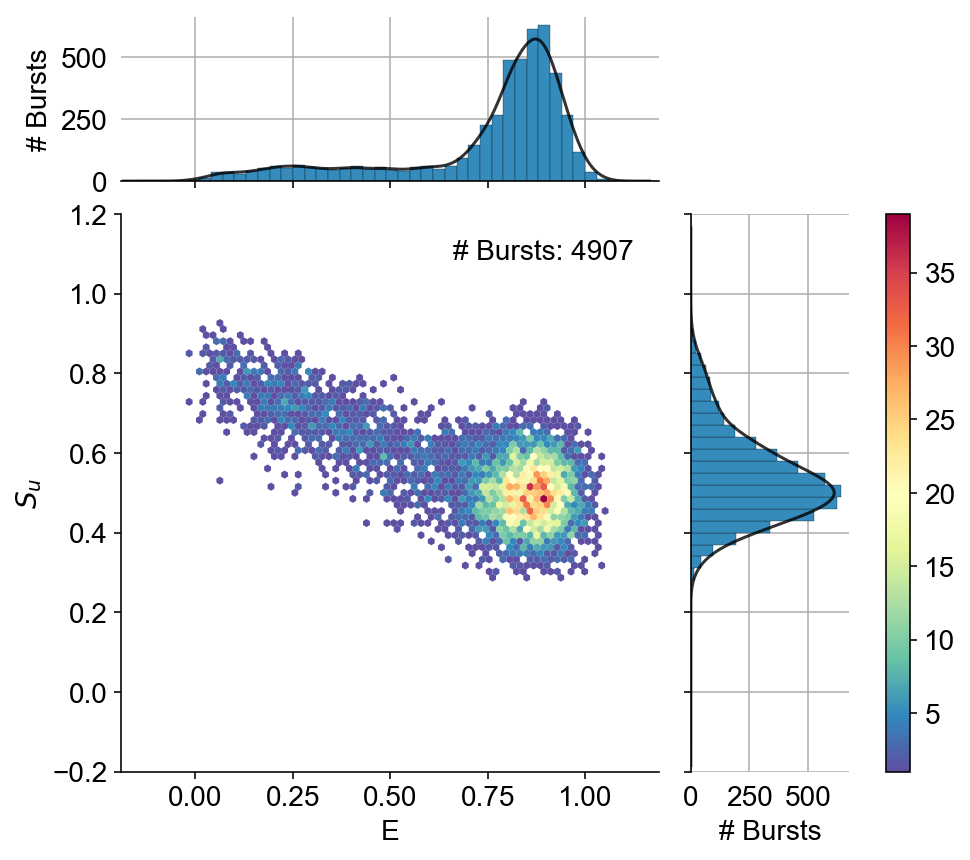

In [155]:
g = alex_jointplot(dcs1, S_name='Su', vmax_fret=False, gridsize=80)
g.ax_joint.set_ylabel('$S_u$');

In [156]:
size_th = 40
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem'), gamma=0.5,
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dcs = dc.select_bursts(select_bursts.size, th1=size_th, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs.nd, dcs.na, dcs.naa)]
dcs.add(Su=Su)
Math(d._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

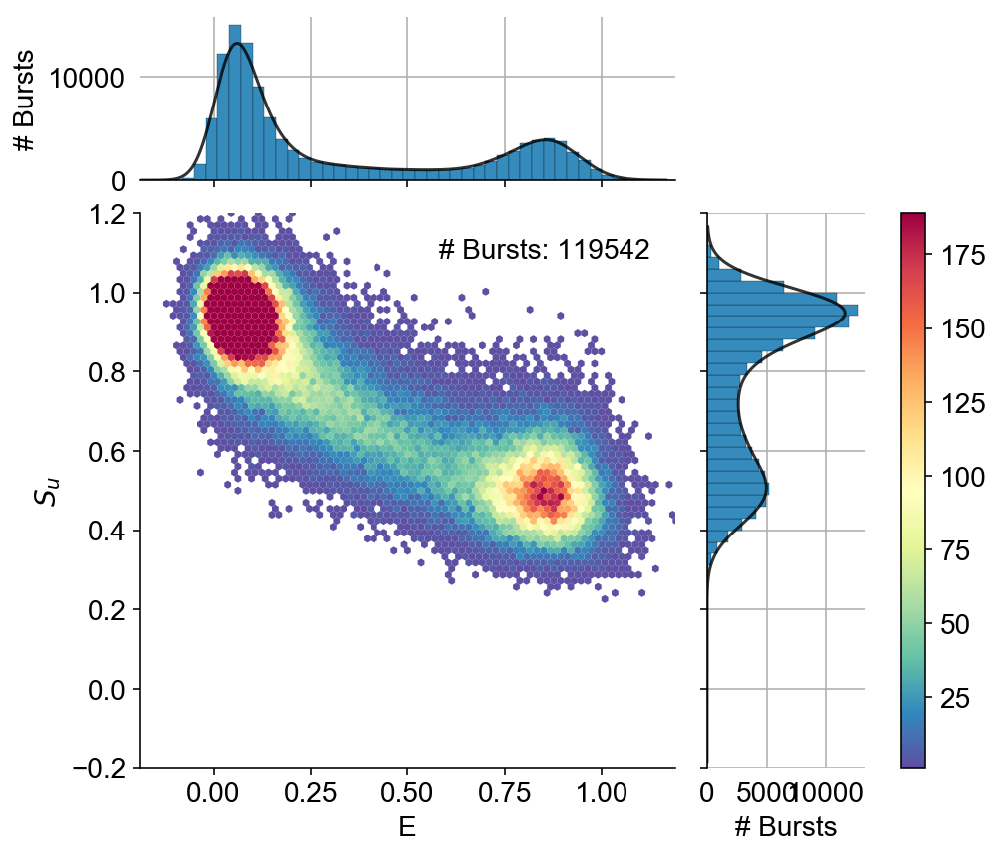

In [157]:
g = alex_jointplot(dcs, S_name='Su', vmax_fret=True, gridsize=80)
g.ax_joint.set_ylabel('$S_u$');

In [158]:
dcs15 = dcs.select_bursts(select_bursts.time, time_s1=0, time_s2=15)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs15.nd, dcs15.na, dcs15.naa)]
dcs15.add(Su=Su)

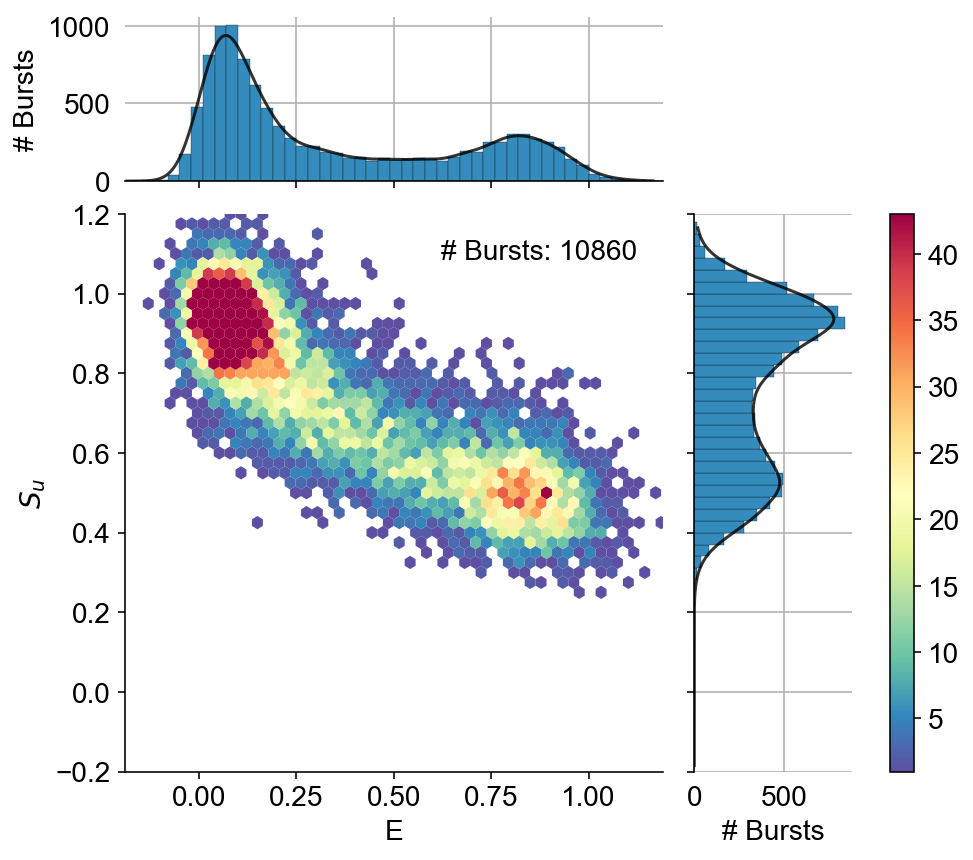

In [159]:
g = alex_jointplot(dcs15, S_name='Su')
g.ax_joint.set_ylabel('$S_u$');

In [160]:
dcs5 = dcs.select_bursts(select_bursts.time, time_s1=0, time_s2=5)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(dcs5.nd, dcs5.na, dcs5.naa)]
dcs5.add(Su=Su)

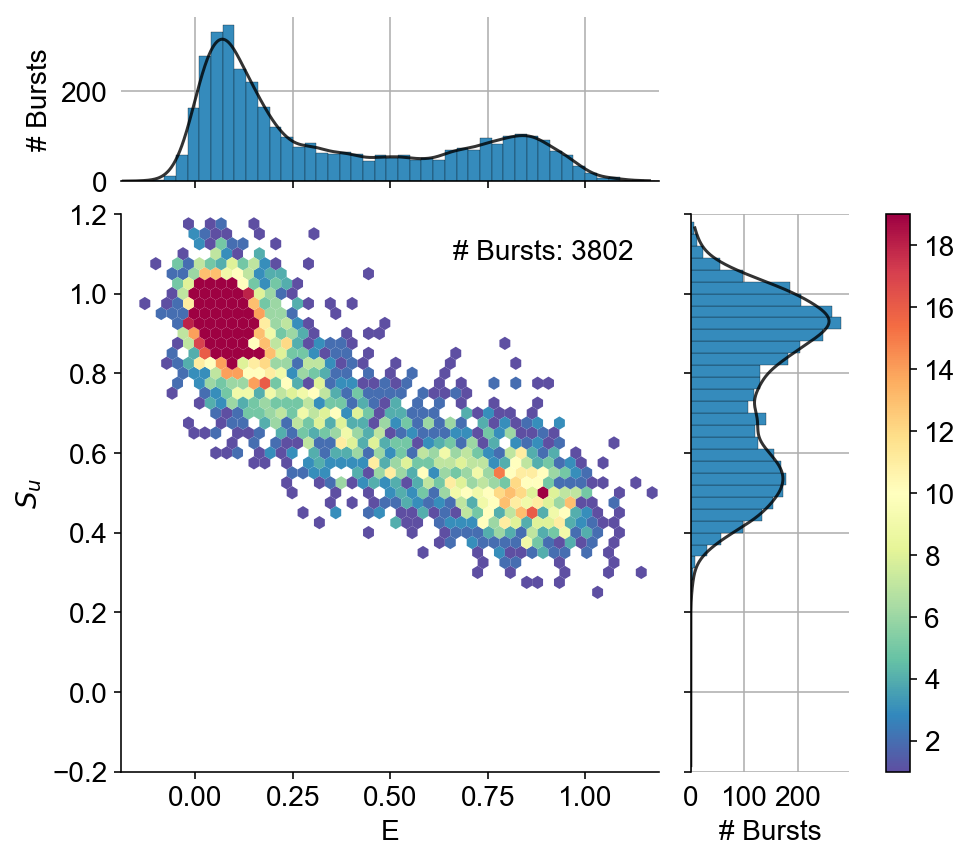

In [161]:
g = alex_jointplot(dcs5, S_name='Su')
g.ax_joint.set_ylabel('$S_u$');